# Teaching a Deep Convolutional Generative Adversarial Network (DCGAN) to draw MNIST characters

In the last tutorial, we learnt using tensorflow for designing a Variational Autoencoder (VAE) that could draw MNIST characters. Most of the created digits looked nice. There was only one drawback -- some of the created images looked a bit fuzzy. The VAE was trained with the _mean squared error_ loss function. However, it's quite difficult to encode exact character edge locations, which leads to the network being unsure about character edges. And does it really matter if the edge of a character starts a few pixels more to the left or right? Not really.
In this article, we will see how we can train a network that does not depend on the mean squared error or any related loss functions. 

## Deep Convolutional Generative Adversarial Networks
Another network architecture for learning to generate new content is the DCGAN. Like the VAE, our DCGAN consists of two parts:
* The _discriminator_ learns how to distinguish fake from real objects of the type we'd like to create
* The _generator_ creates new content and tries to fool the discriminator

There is a HackerNoon article by Chanchana Sornsoontorn that explains the concept in more detail and describes some creative projects DCGANs have been applied to. One of these projects is the generation of MNIST characters. Let's try to use python and tensorflow for the same purpose.

In [65]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

from tensorflow.examples.tutorials.mnist import input_data
mnist = input_data.read_data_sets('MNIST_data')

In [75]:
def montage(images):
    if isinstance(images, list):
        images = np.array(images)
    img_h = images.shape[1]
    img_w = images.shape[2]
    n_plots = int(np.ceil(np.sqrt(images.shape[0])))
    m = np.ones((images.shape[1] * n_plots + n_plots + 1, images.shape[2] * n_plots + n_plots + 1)) * 0.5
    for i in range(n_plots):
        for j in range(n_plots):
            this_filter = i * n_plots + j
            if this_filter < images.shape[0]:
                this_img = images[this_filter]
                m[1 + i + i * img_h:1 + i + (i + 1) * img_h,
                  1 + j + j * img_w:1 + j + (j + 1) * img_w] = this_img
    return m

## Defining the basics
Like in the last tutorial, we use tensorflow's own method for accessing batches of MNIST characters. We set our batch size to be 64. Our generator will -- just like the VAE -- take inputs which are sampled from a unit Gaussian Distribution. The number of these inputs is being set to 100. Batch normalization considerably improved the training of this network. For tensorflow to apply batch normalization, we need to let it know whether we are in training mode. The variable _keep_prob_ will be used by our dropout layers, which we introduce for more stable learning outcomes.

In [256]:
tf.reset_default_graph()
batch_size = 64
n_noise = 64

X_in = tf.placeholder(dtype=tf.float32, shape=[None, 28, 28], name='X')
noise = tf.placeholder(dtype=tf.float32, shape=[None, n_noise])

keep_prob = tf.placeholder(dtype=tf.float32, name='keep_prob')
is_training = tf.placeholder(dtype=tf.bool, name='is_training')

def lrelu(x):
    return tf.maximum(x, tf.multiply(x, 0.2))

def binary_cross_entropy(x, z):
    eps = 1e-12
    return (-(x * tf.log(z + eps) + (1. - x) * tf.log(1. - z + eps)))

def discriminator(img_in, reuse=None, keep_prob=keep_prob):
    activation = lrelu
    with tf.variable_scope("discriminator", reuse=reuse):
        x = tf.reshape(img_in, shape=[-1, 28, 28, 1])
        x = tf.layers.conv2d(x, kernel_size=5, filters=64, strides=2, padding='same', activation=activation)
        x = tf.layers.dropout(x, keep_prob)
        x = tf.layers.conv2d(x, kernel_size=5, filters=64, strides=1, padding='same', activation=activation)
        x = tf.layers.dropout(x, keep_prob)
        x = tf.layers.conv2d(x, kernel_size=5, filters=64, strides=1, padding='same', activation=activation)
        x = tf.layers.dropout(x, keep_prob)
        x = tf.contrib.layers.flatten(x)
        x = tf.layers.dense(x, units=128, activation=activation)
        x = tf.layers.dense(x, units=1, activation=tf.nn.sigmoid)
        return x
    
def generator(z, keep_prob=keep_prob, is_training=is_training):
    activation = lrelu
    momentum = 0.9
    with tf.variable_scope("generator", reuse=None):
        x = z
        
        d1 = 4#3
        d2 = 1
        
        x = tf.layers.dense(x, units=d1 * d1 * d2, activation=activation)
        x = tf.layers.dropout(x, keep_prob)      
        x = tf.contrib.layers.batch_norm(x, is_training=is_training, decay=momentum)  
        
        x = tf.reshape(x, shape=[-1, d1, d1, d2])
        x = tf.image.resize_images(x, size=[7, 7])
#        x = tf.reshape(x, shape=[-1, 7, 7, 1])
        
        
        
        x = tf.layers.conv2d_transpose(x, kernel_size=5, filters=64, strides=2, padding='same', activation=activation)
        x = tf.layers.dropout(x, keep_prob)
        x = tf.contrib.layers.batch_norm(x, is_training=is_training, decay=momentum)
        x = tf.layers.conv2d_transpose(x, kernel_size=5, filters=64, strides=2, padding='same', activation=activation)
        x = tf.layers.dropout(x, keep_prob)
        x = tf.contrib.layers.batch_norm(x, is_training=is_training, decay=momentum)
        x = tf.layers.conv2d_transpose(x, kernel_size=5, filters=64, strides=1, padding='same', activation=activation)
        x = tf.layers.dropout(x, keep_prob)
        x = tf.contrib.layers.batch_norm(x, is_training=is_training, decay=momentum)
        x = tf.layers.conv2d_transpose(x, kernel_size=5, filters=1, strides=1, padding='same', activation=tf.nn.sigmoid)
        return x    

In [ ]:
g = generator(noise, keep_prob, is_training)
print(g)
d_real = discriminator(X_in)
d_fake = discriminator(g, reuse=True)

vars_g = [var for var in tf.trainable_variables() if var.name.startswith("generator")]
vars_d = [var for var in tf.trainable_variables() if var.name.startswith("discriminator")]


d_reg = tf.contrib.layers.apply_regularization(tf.contrib.layers.l2_regularizer(1e-6), vars_d)
g_reg = tf.contrib.layers.apply_regularization(tf.contrib.layers.l2_regularizer(1e-6), vars_g)

loss_d_real = binary_cross_entropy(tf.ones_like(d_real), d_real)
loss_d_fake = binary_cross_entropy(tf.zeros_like(d_fake), d_fake)
loss_g = tf.reduce_mean(binary_cross_entropy(tf.ones_like(d_fake), d_fake))

loss_d = tf.reduce_mean(0.5 * (loss_d_real + loss_d_fake))

update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
with tf.control_dependencies(update_ops):
    optimizer_d = tf.train.RMSPropOptimizer(learning_rate=0.0001).minimize(loss_d + d_reg, var_list=vars_d)
    optimizer_g = tf.train.RMSPropOptimizer(learning_rate=0.0002).minimize(loss_g + g_reg, var_list=vars_g)
sess = tf.Session()
sess.run(tf.global_variables_initializer())

Tensor("generator/conv2d_transpose_4/Sigmoid:0", shape=(?, 28, 28, 1), dtype=float32)


(0, 0.69985449, 0.67829978)


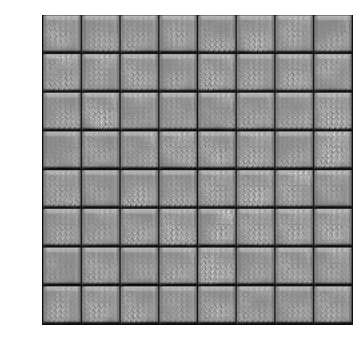

(50, 0.69454503, 0.69071704)


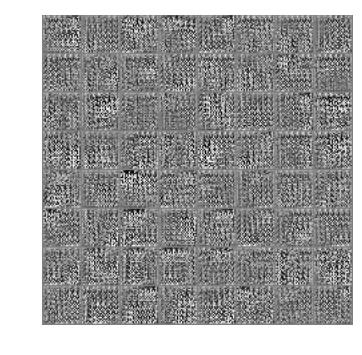

(100, 0.62565744, 0.85674399)
not training discriminator


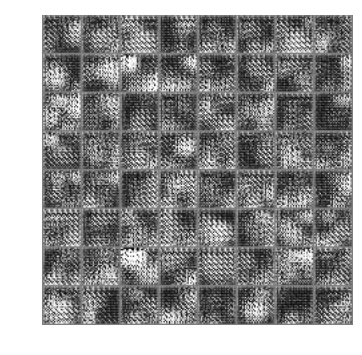

(150, 0.61221302, 0.82491899)


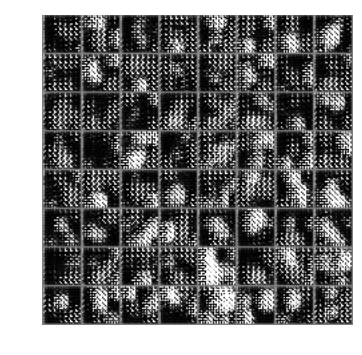

(200, 0.61760223, 0.82269728)


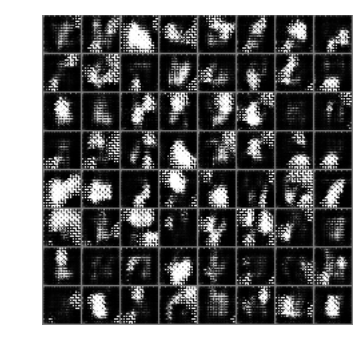

(250, 0.61730242, 0.91875893)
not training discriminator


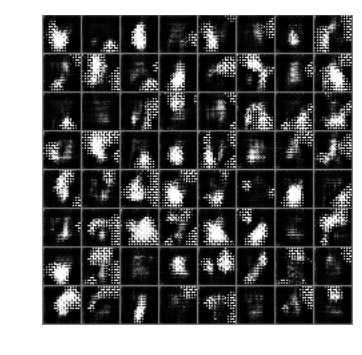

(300, 0.63360512, 0.67489481)


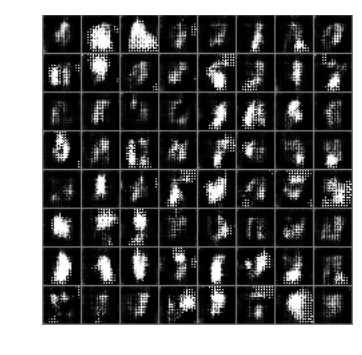

(350, 0.64373881, 0.65905666)


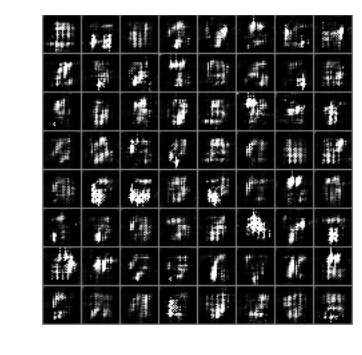

(400, 0.64736295, 0.93996465)
not training discriminator


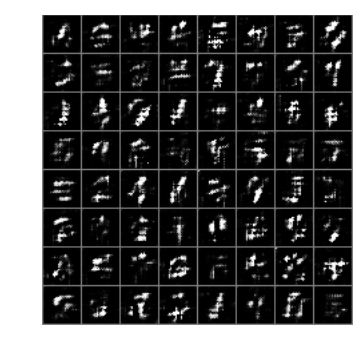

(450, 0.64123976, 0.65132654)


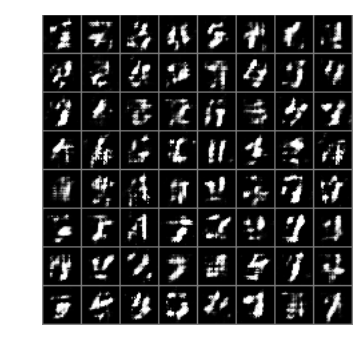

(500, 0.77116799, 1.0618949)
not training discriminator


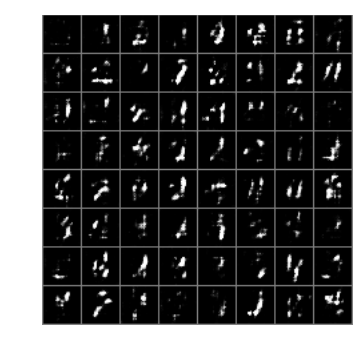

(550, 0.73274297, 1.1369185)
not training discriminator


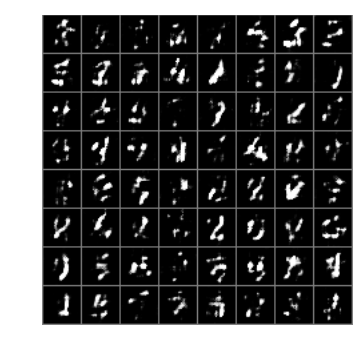

(600, 0.62473333, 0.90919828)
not training discriminator


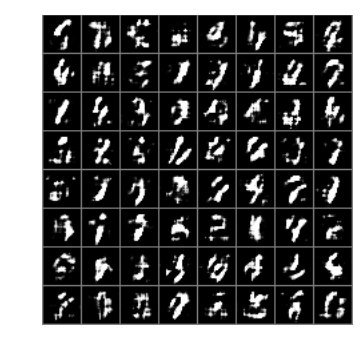

(650, 0.75725383, 1.1372364)
not training discriminator


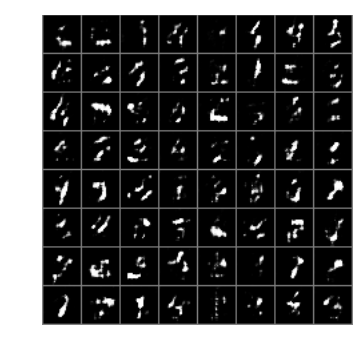

(700, 0.79681885, 1.1343896)
not training discriminator


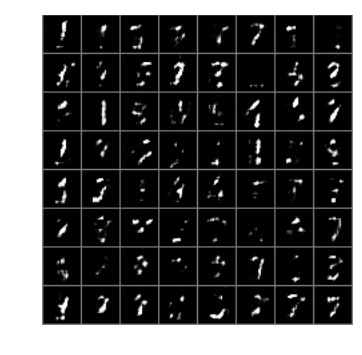

(750, 0.67060459, 0.93834978)
not training discriminator


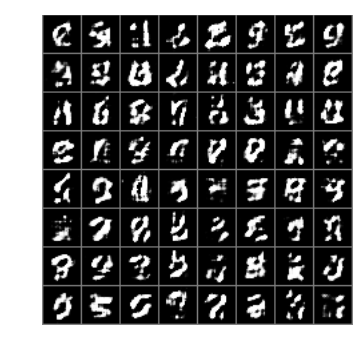

(800, 0.65103555, 0.91792756)
not training discriminator


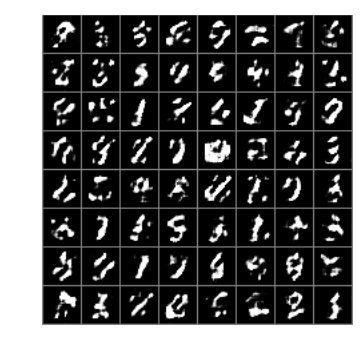

(850, 0.71549904, 0.97357607)
not training discriminator


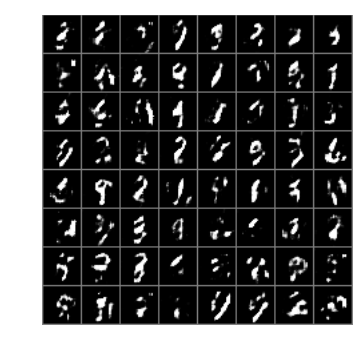

(900, 0.72334677, 1.0984919)
not training discriminator


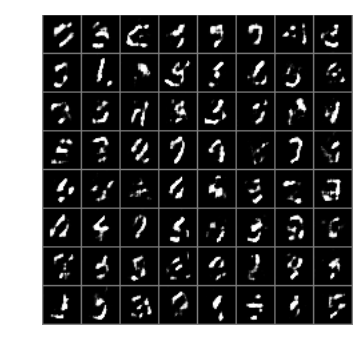

(950, 0.66422403, 0.97994894)
not training discriminator


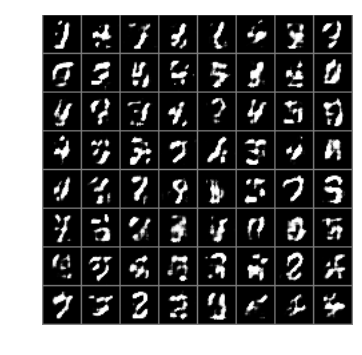

(1000, 0.59529358, 0.6384362)


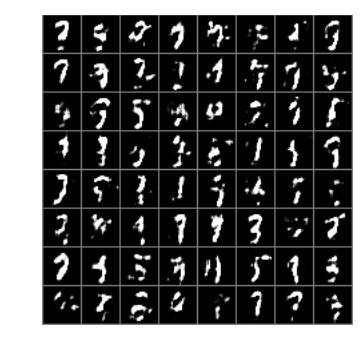

(1050, 0.67236823, 0.96270674)
not training discriminator


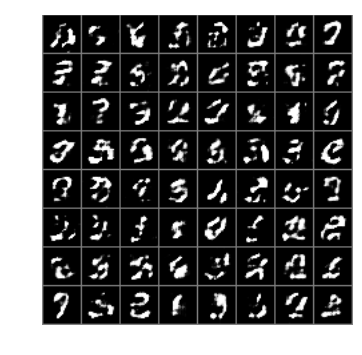

(1100, 0.69562435, 1.0263085)
not training discriminator


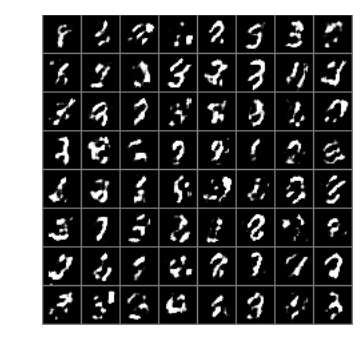

(1150, 0.65396631, 0.90280569)
not training discriminator


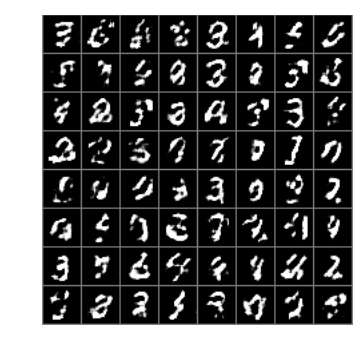

(1200, 0.63407564, 0.76791739)


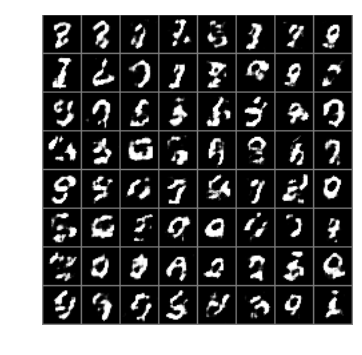

(1250, 0.74207872, 1.1265242)
not training discriminator


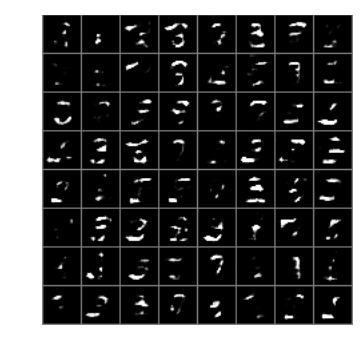

(1300, 0.60416925, 0.90557826)
not training discriminator


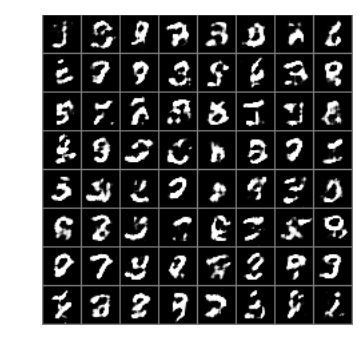

(1350, 0.7009849, 1.0185256)
not training discriminator


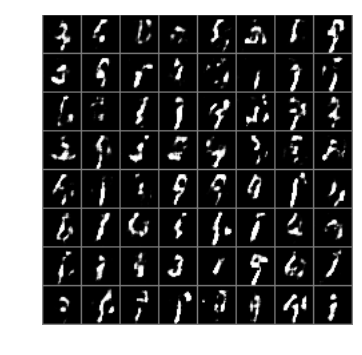

(1400, 0.62071335, 0.85116792)
not training discriminator


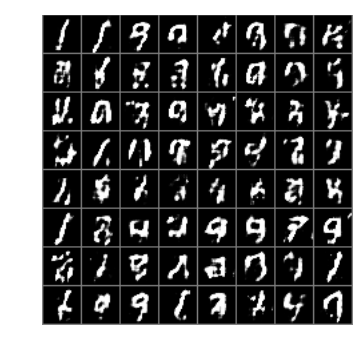

(1450, 0.75127447, 1.0281825)
not training discriminator


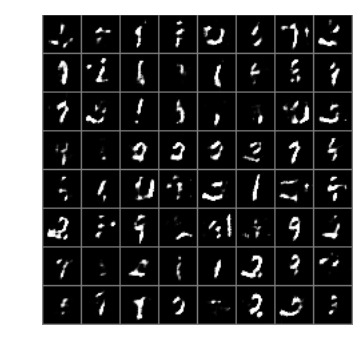

(1500, 0.61343646, 0.92715496)
not training discriminator


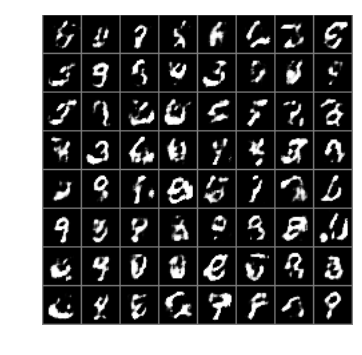

(1550, 0.64688337, 0.88852692)
not training discriminator


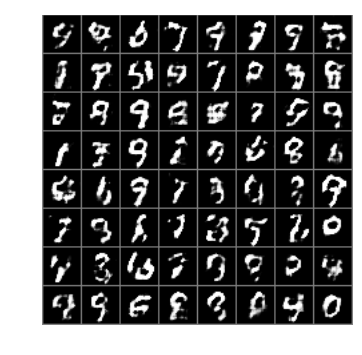

(1600, 0.69067371, 1.0124803)
not training discriminator


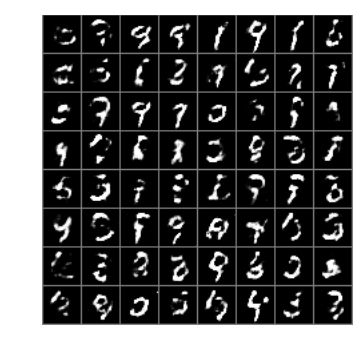

(1650, 0.68322635, 1.0112501)
not training discriminator


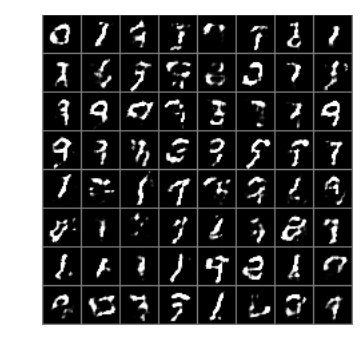

(1700, 0.67208332, 0.93745995)
not training discriminator


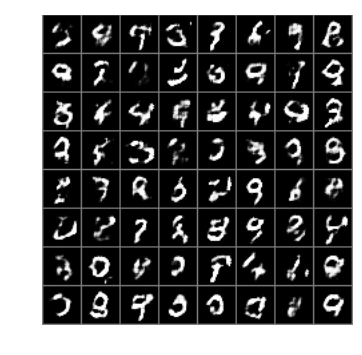

(1750, 0.67196727, 0.92289579)
not training discriminator


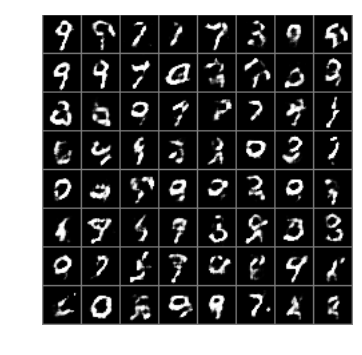

(1800, 0.6523416, 0.91041094)
not training discriminator


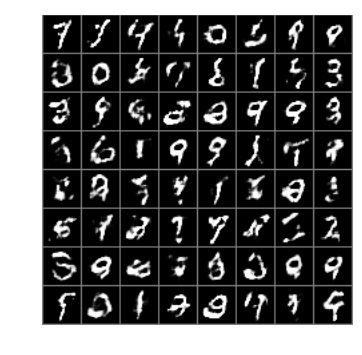

(1850, 0.67914867, 0.95780933)
not training discriminator


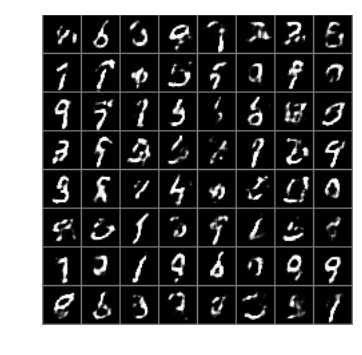

(1900, 0.74298704, 1.0892551)
not training discriminator


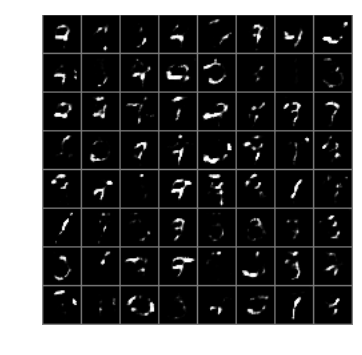

(1950, 0.79580557, 1.1169598)
not training discriminator


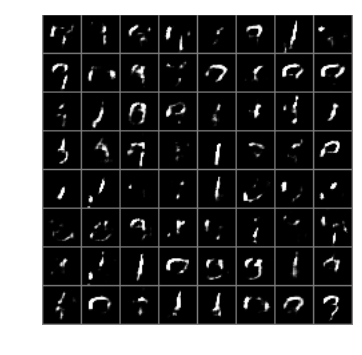

(2000, 0.69938356, 1.0701463)
not training discriminator


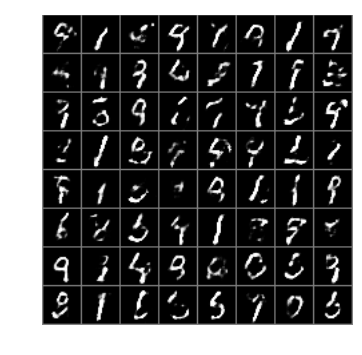

(2050, 0.71970832, 1.0337999)
not training discriminator


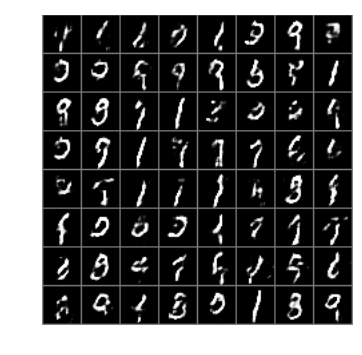

(2100, 0.59991598, 0.76701725)


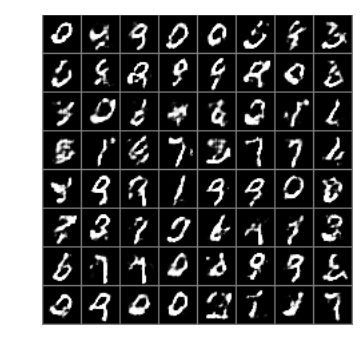

(2150, 0.75875628, 1.0317243)
not training discriminator


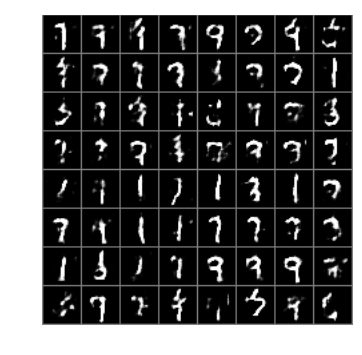

(2200, 0.7152878, 1.0919913)
not training discriminator


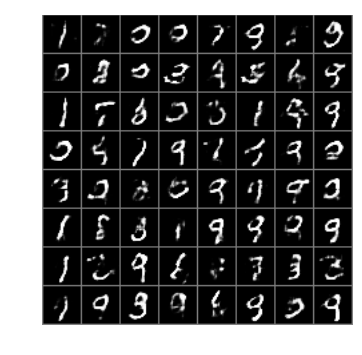

(2250, 0.72476584, 1.0439959)
not training discriminator


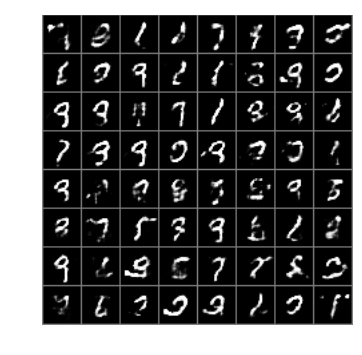

(2300, 0.65890837, 0.86469895)


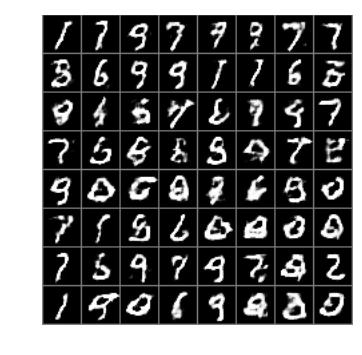

(2350, 0.69879717, 1.0646486)
not training discriminator


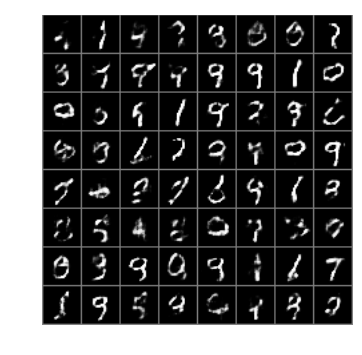

(2400, 0.72601759, 1.1095273)
not training discriminator


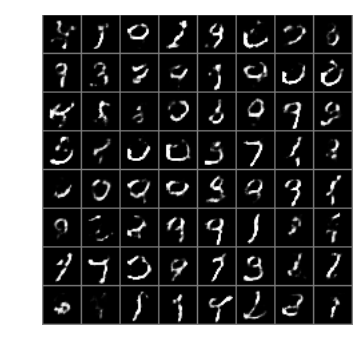

(2450, 0.67531061, 0.51265538)


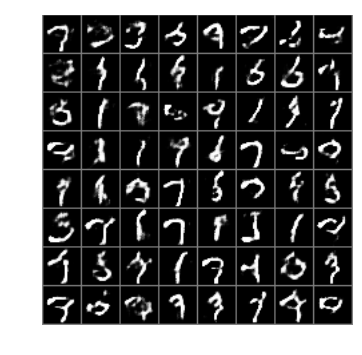

(2500, 0.57637423, 0.75592673)


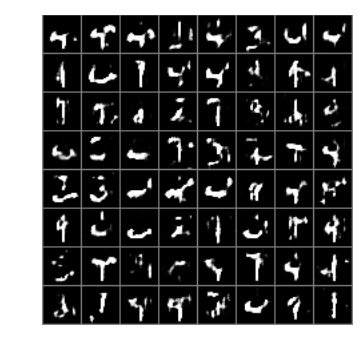

(2550, 0.74458528, 1.0457408)
not training discriminator


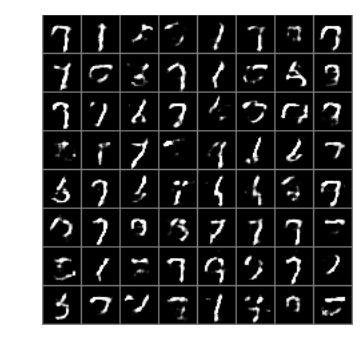

(2600, 0.66819859, 0.93241417)
not training discriminator


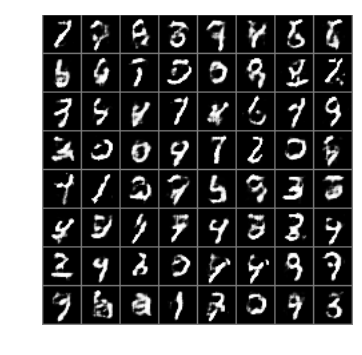

(2650, 0.71744311, 0.93800151)


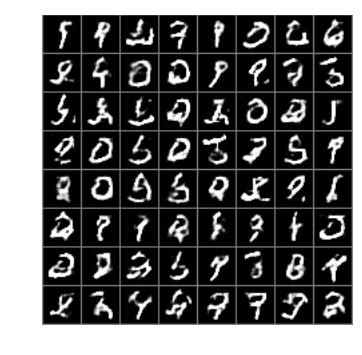

(2700, 0.62377775, 0.74151719)


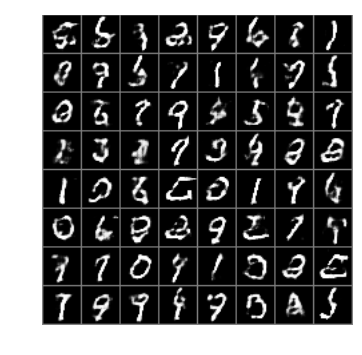

(2750, 0.63401765, 0.82405758)


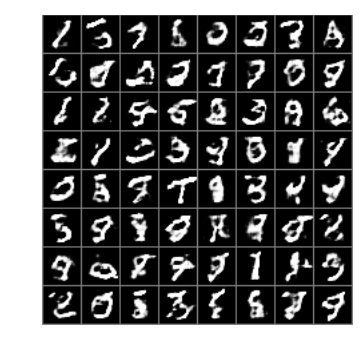

(2800, 0.85583103, 1.1561776)
not training discriminator


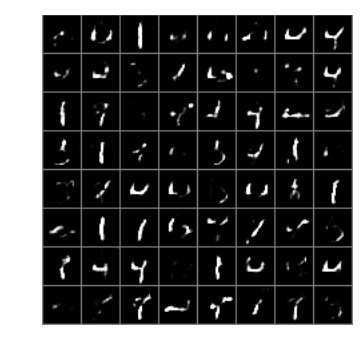

(2850, 0.7464726, 0.97690773)


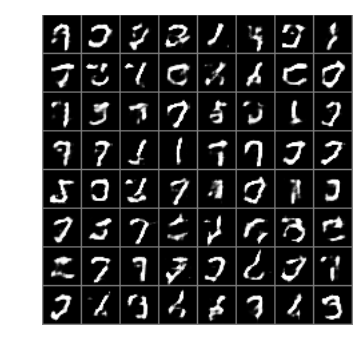

(2900, 0.67240751, 0.99708462)
not training discriminator


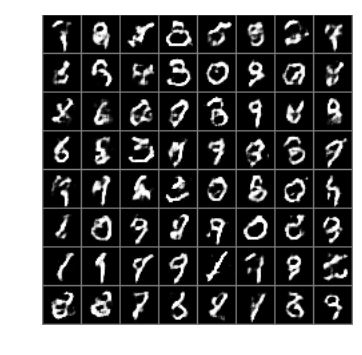

(2950, 0.71759963, 0.94598079)


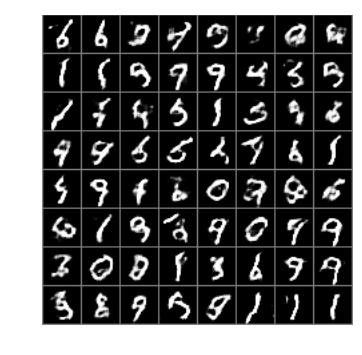

(3000, 0.7058053, 0.96257639)
not training discriminator


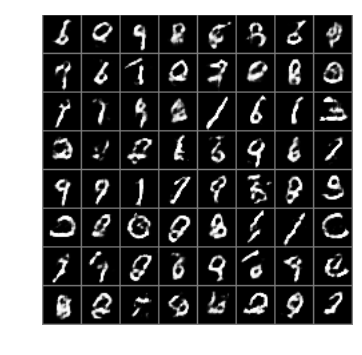

(3050, 0.72913283, 1.0658858)
not training discriminator


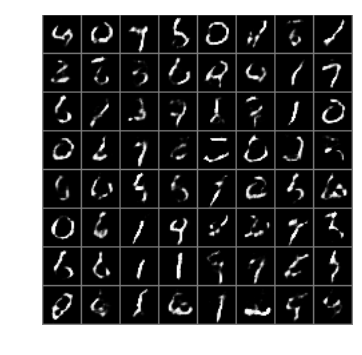

(3100, 0.67685604, 0.97802043)
not training discriminator


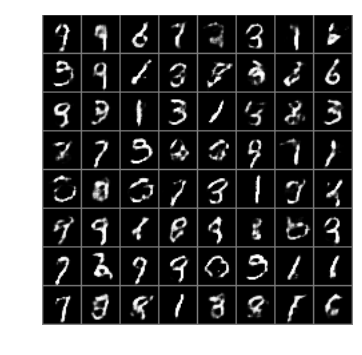

(3150, 0.7529062, 1.1997296)
not training discriminator


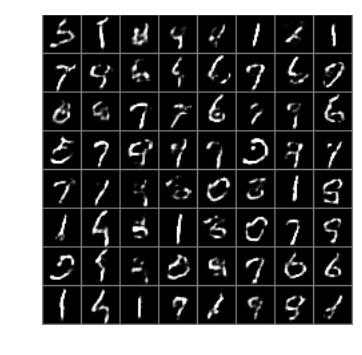

(3200, 0.61304033, 0.91176629)
not training discriminator


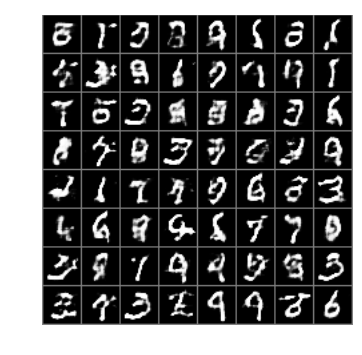

(3250, 0.85631931, 1.2101376)
not training discriminator


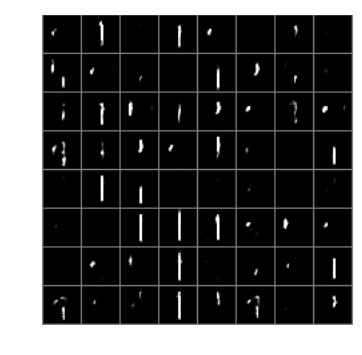

(3300, 0.6212613, 1.0314558)
not training discriminator


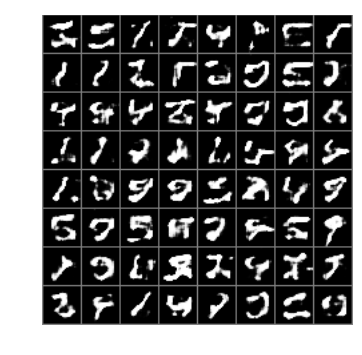

(3350, 0.66838193, 0.99475271)
not training discriminator


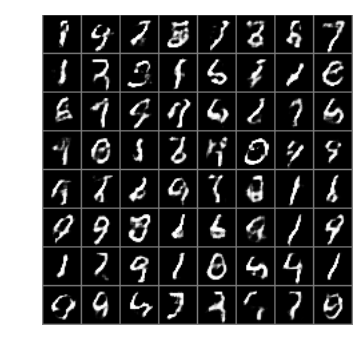

(3400, 0.67970139, 0.96422958)
not training discriminator


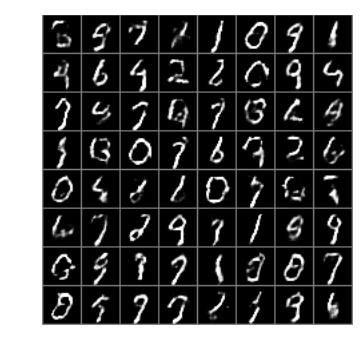

(3450, 0.64450645, 0.64532298)


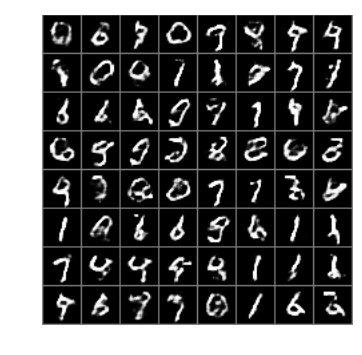

(3500, 0.71683955, 1.0257168)
not training discriminator


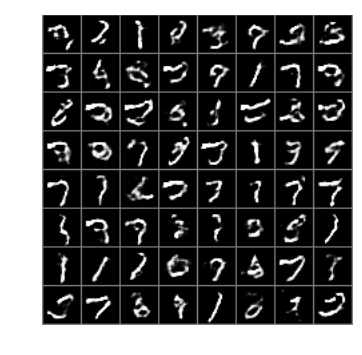

(3550, 0.76002717, 1.1352589)
not training discriminator


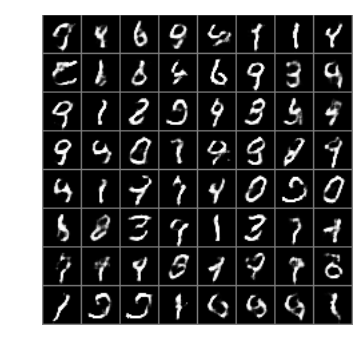

(3600, 0.65185666, 1.0135956)
not training discriminator


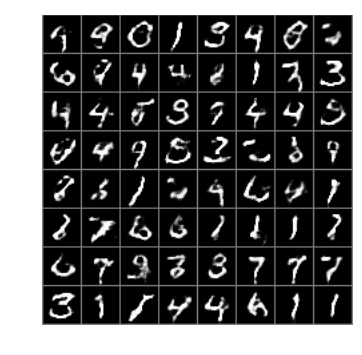

(3650, 0.65553868, 0.95186216)
not training discriminator


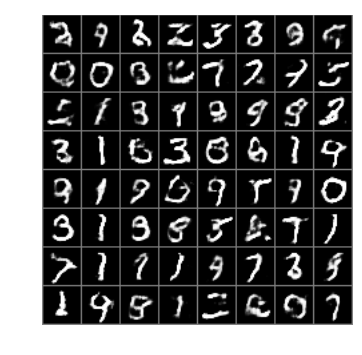

(3700, 0.792588, 1.075491)
not training discriminator


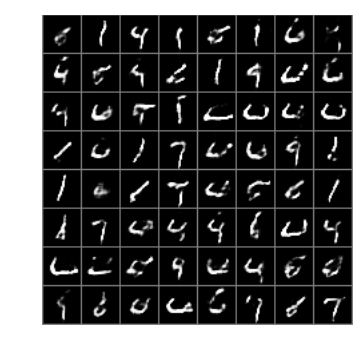

(3750, 0.76166177, 1.1478121)
not training discriminator


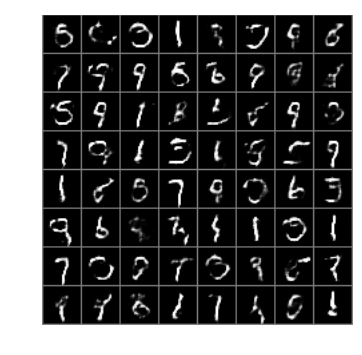

(3800, 0.69315875, 1.029362)
not training discriminator


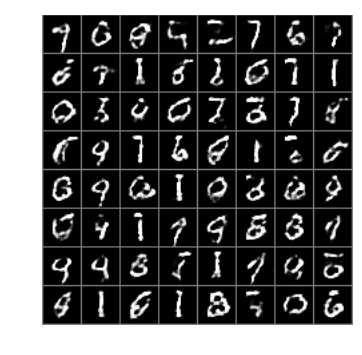

(3850, 0.75932121, 1.1644459)
not training discriminator


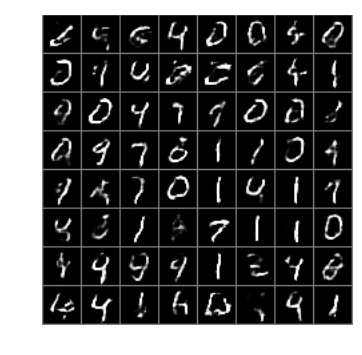

(3900, 0.62400758, 0.80216581)


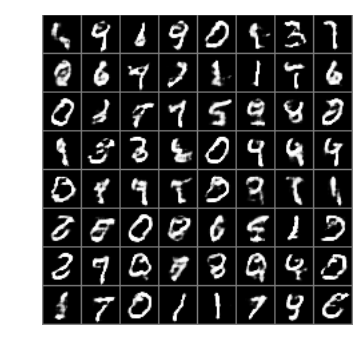

(3950, 0.6898132, 0.99651521)
not training discriminator


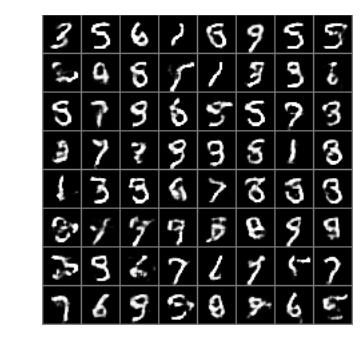

(4000, 0.66495645, 0.63829648)


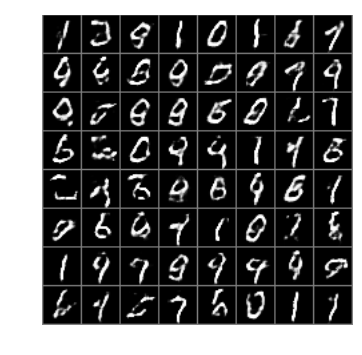

(4050, 0.68273216, 1.0037925)
not training discriminator


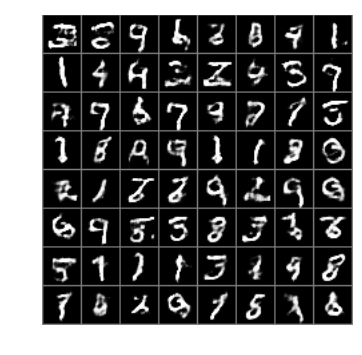

(4100, 0.70801687, 0.98680693)
not training discriminator


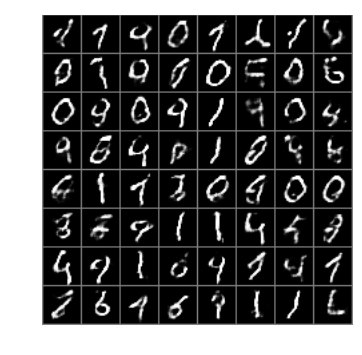

(4150, 0.62745035, 0.87113333)
not training discriminator


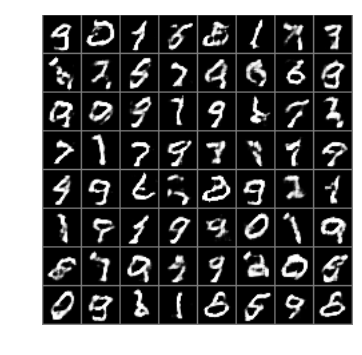

(4200, 0.69649327, 0.97281957)
not training discriminator


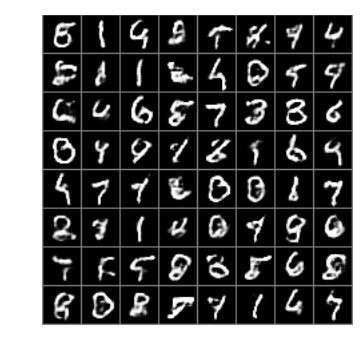

(4250, 0.64029646, 0.8583076)


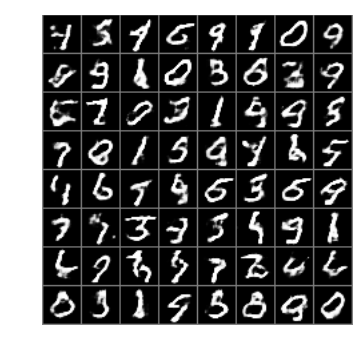

(4300, 0.79011405, 1.1283484)
not training discriminator


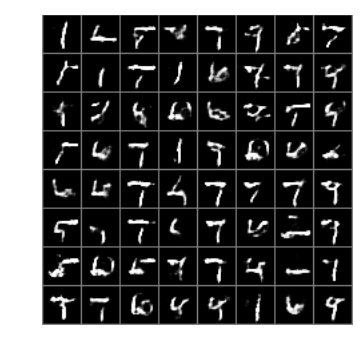

(4350, 0.67644876, 0.92233312)
not training discriminator


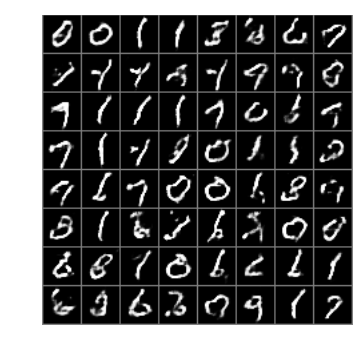

(4400, 0.62508112, 0.93341935)
not training discriminator


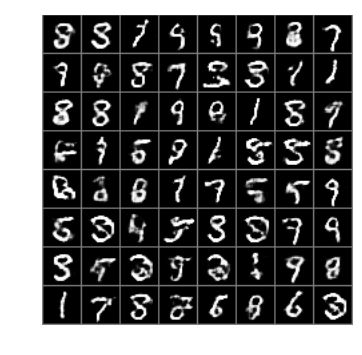

(4450, 0.68844581, 0.57854891)


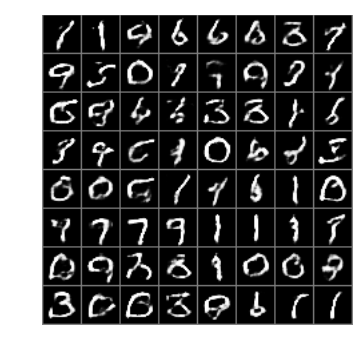

(4500, 0.66130435, 1.0117701)
not training discriminator


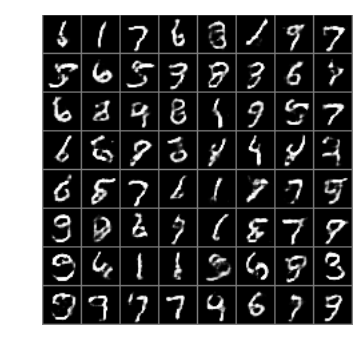

(4550, 0.65390354, 0.96493435)
not training discriminator


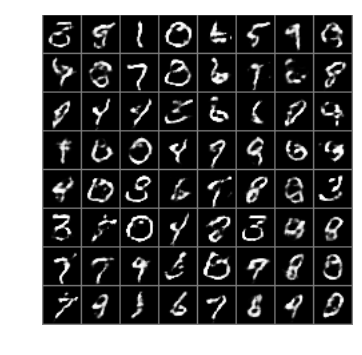

(4600, 0.64763927, 0.95292413)
not training discriminator


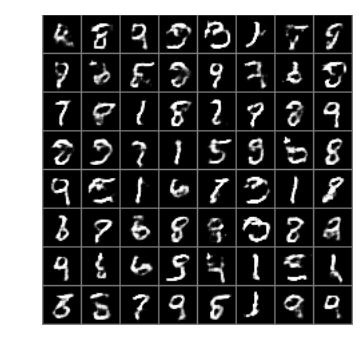

(4650, 0.65094239, 0.880458)
not training discriminator


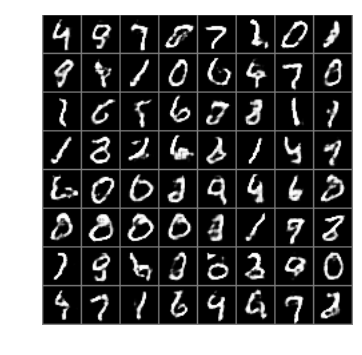

(4700, 0.65032834, 0.93955618)
not training discriminator


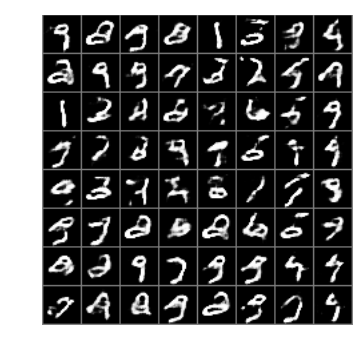

(4750, 0.76149189, 1.0886743)
not training discriminator


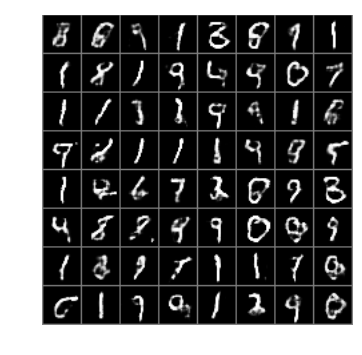

(4800, 0.73398781, 1.2058073)
not training discriminator


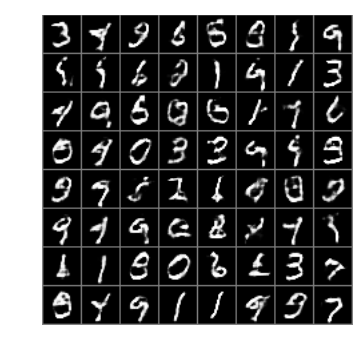

(4850, 0.72204554, 1.1064671)
not training discriminator


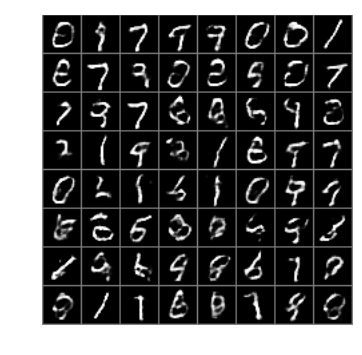

(4900, 0.72765446, 1.1092467)
not training discriminator


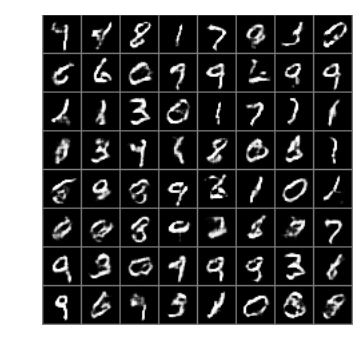

(4950, 0.72897279, 1.0379341)
not training discriminator


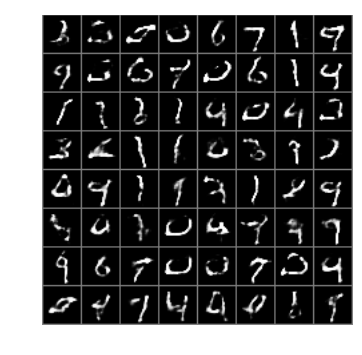

(5000, 0.7821039, 1.2819834)
not training discriminator


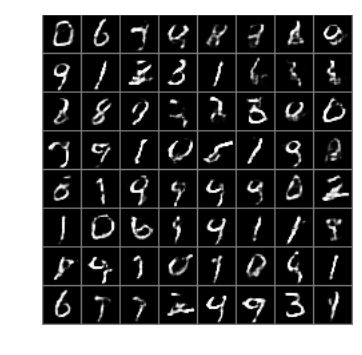

(5050, 0.57695937, 0.81299746)
not training discriminator


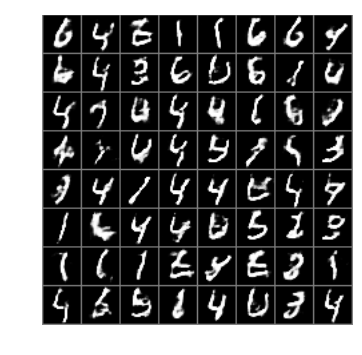

(5100, 0.67114514, 0.59538388)


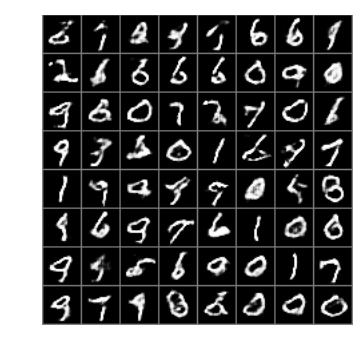

(5150, 0.67956829, 1.0475931)
not training discriminator


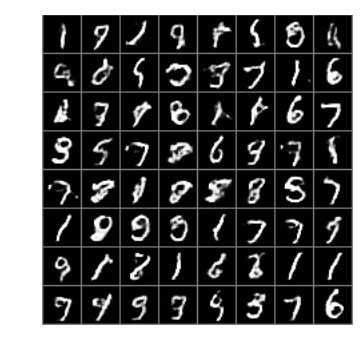

(5200, 0.68948883, 0.93180346)
not training discriminator


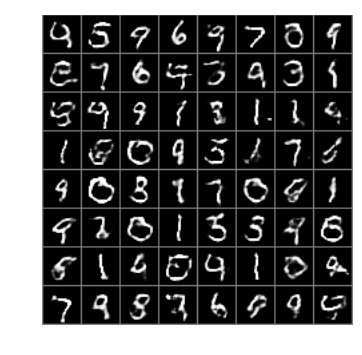

(5250, 0.65064442, 0.81164753)


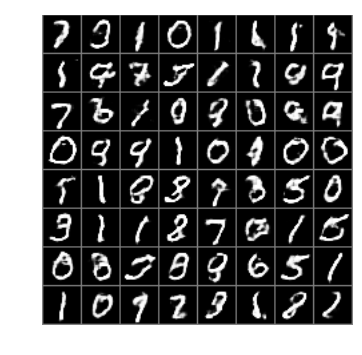

(5300, 0.67198592, 0.97396433)
not training discriminator


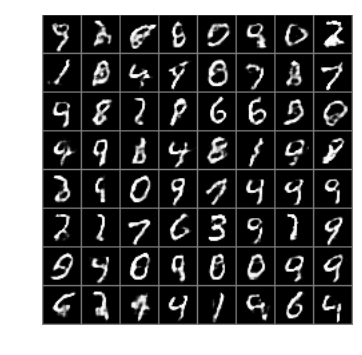

(5350, 0.70988917, 1.1384552)
not training discriminator


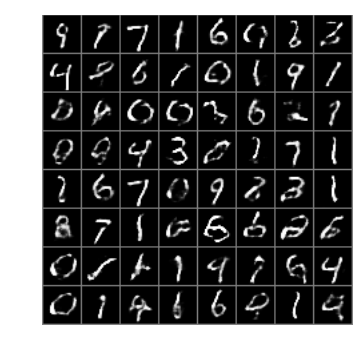

(5400, 0.70024836, 0.48669982)
not training generator


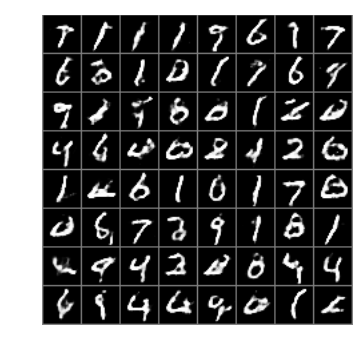

(5450, 0.76987702, 0.98890442)


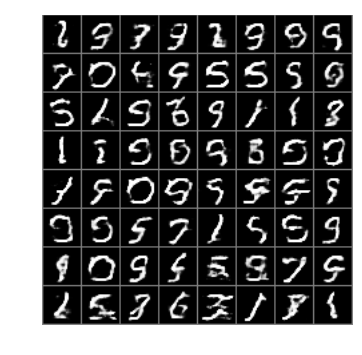

(5500, 0.65038359, 0.85583574)


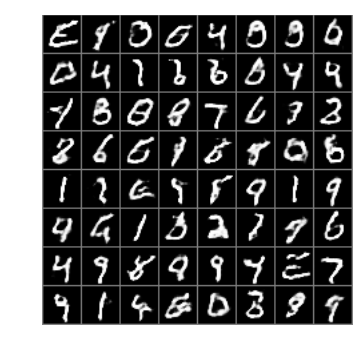

(5550, 0.66968501, 0.96265757)
not training discriminator


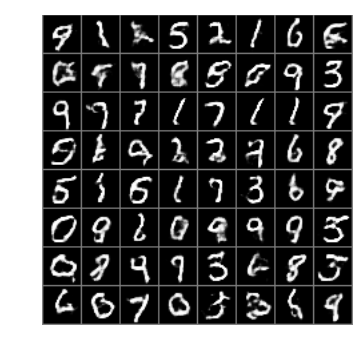

(5600, 0.67049533, 0.97853285)
not training discriminator


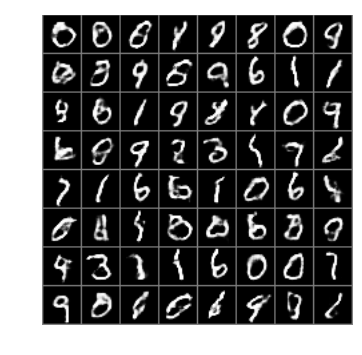

(5650, 0.67536247, 0.91821337)
not training discriminator


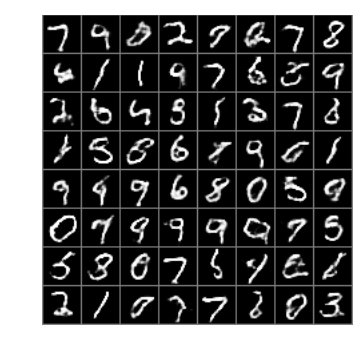

(5700, 0.64262682, 0.85625541)


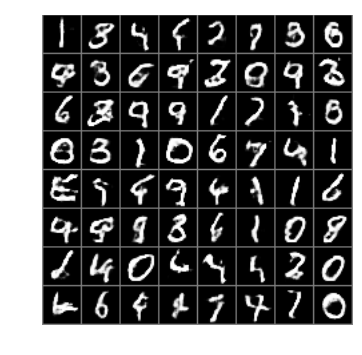

(5750, 0.7291944, 1.0006703)
not training discriminator


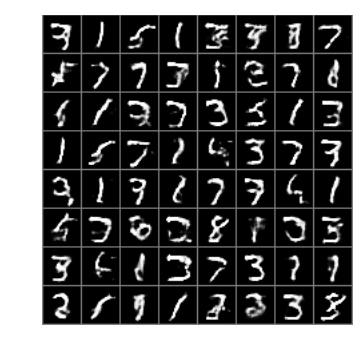

(5800, 0.6768539, 0.98207688)
not training discriminator


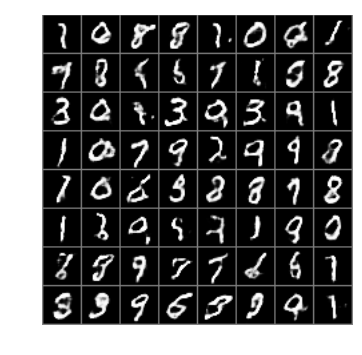

(5850, 0.68699157, 1.0699139)
not training discriminator


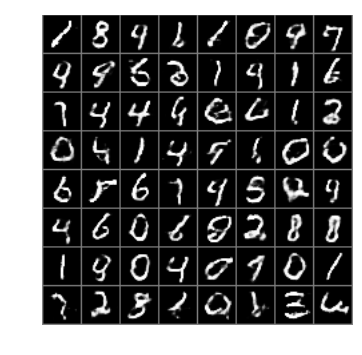

(5900, 0.65457606, 0.69178104)


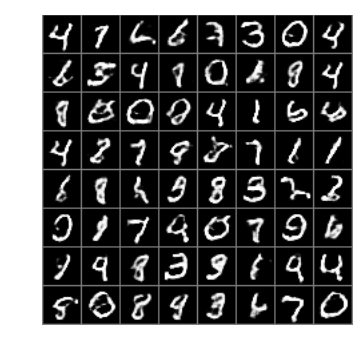

(5950, 0.66589487, 1.0199353)
not training discriminator


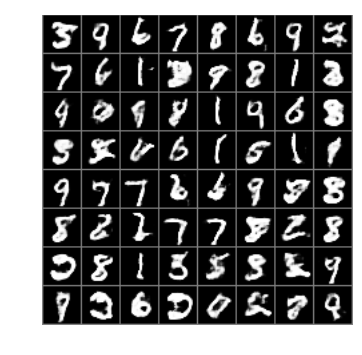

(6000, 0.68726087, 1.0519761)
not training discriminator


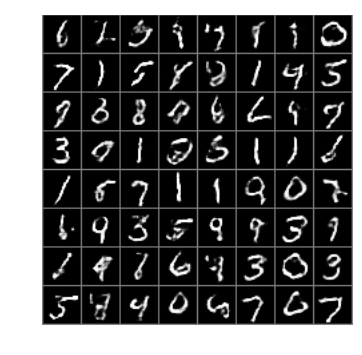

(6050, 0.64359677, 0.80042756)


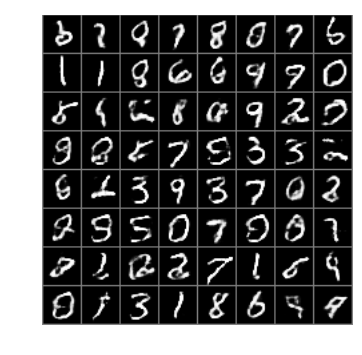

(6100, 0.66874528, 0.89417166)


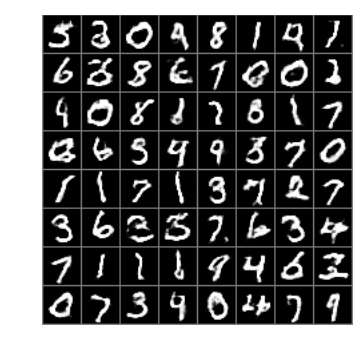

(6150, 0.68599927, 1.0349243)
not training discriminator


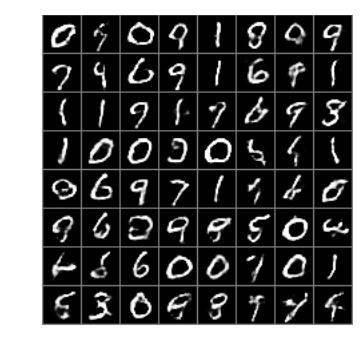

(6200, 0.65451938, 0.66678047)


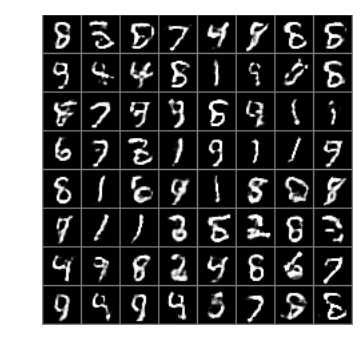

(6250, 0.68749368, 0.97648704)
not training discriminator


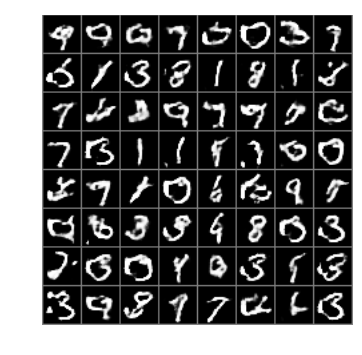

(6300, 0.67807651, 0.92089057)
not training discriminator


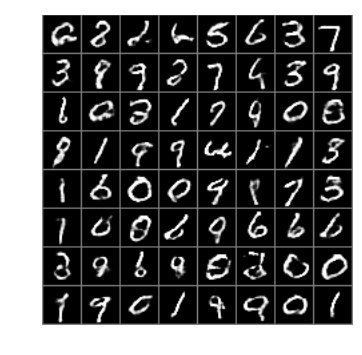

(6350, 0.65418804, 0.87046403)


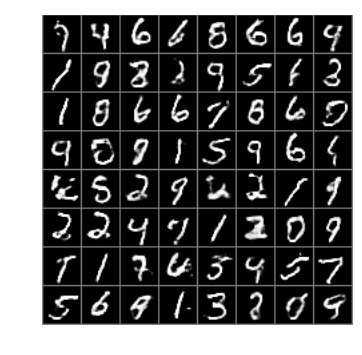

(6400, 0.65318239, 0.61598778)


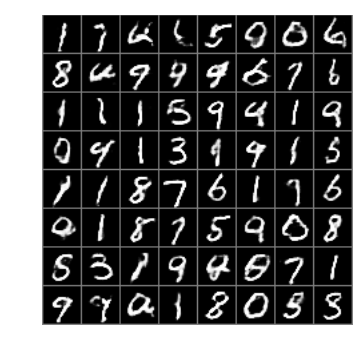

(6450, 0.66954267, 0.95195538)
not training discriminator


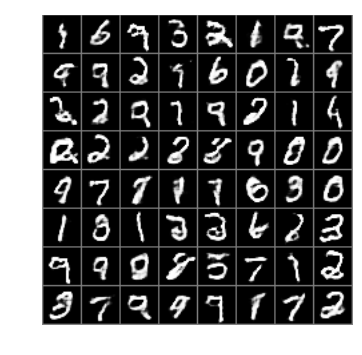

(6500, 0.66905844, 1.0230713)
not training discriminator


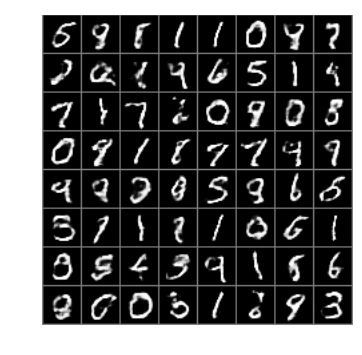

(6550, 0.65143949, 0.91755038)
not training discriminator


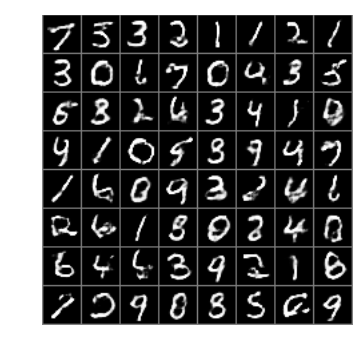

(6600, 0.68245757, 0.93531346)
not training discriminator


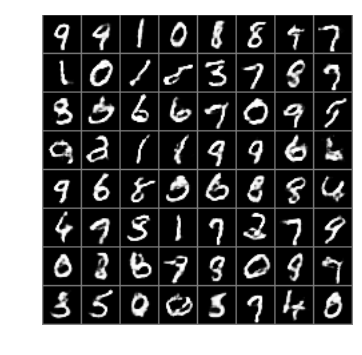

(6650, 0.64239275, 0.62502658)


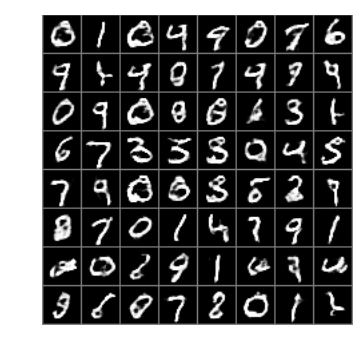

(6700, 0.71582103, 0.97534597)
not training discriminator


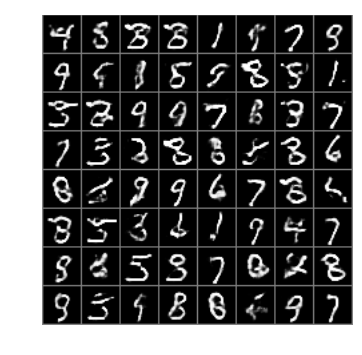

(6750, 0.66124499, 0.57469487)


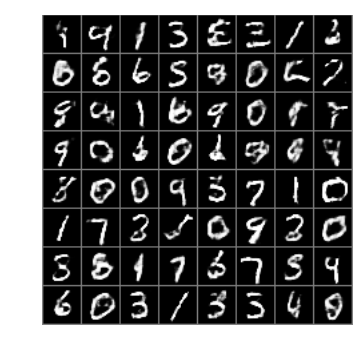

(6800, 0.75162756, 1.2010738)
not training discriminator


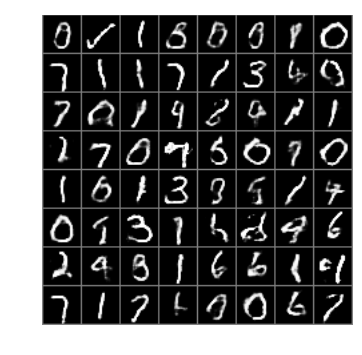

(6850, 0.65883446, 0.98454666)
not training discriminator


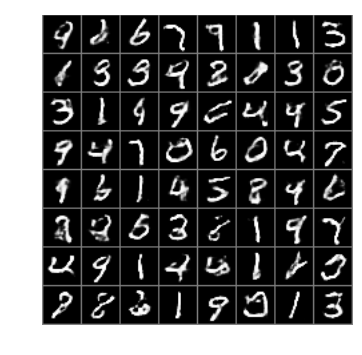

(6900, 0.65770888, 0.63558936)


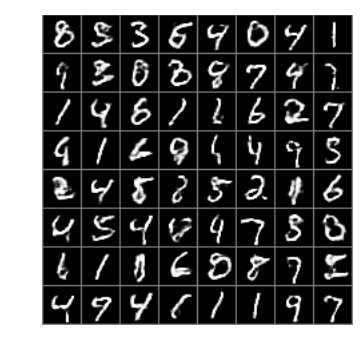

(6950, 0.69022614, 0.95711076)
not training discriminator


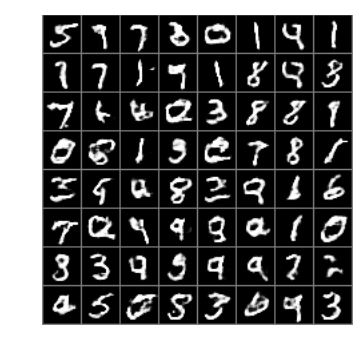

(7000, 0.68649828, 0.91796285)


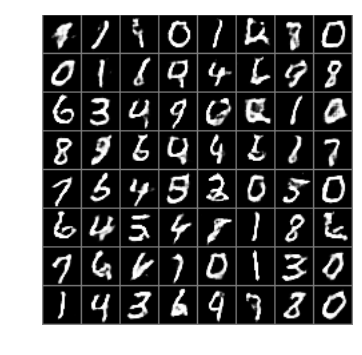

(7050, 0.68478924, 1.0214328)
not training discriminator


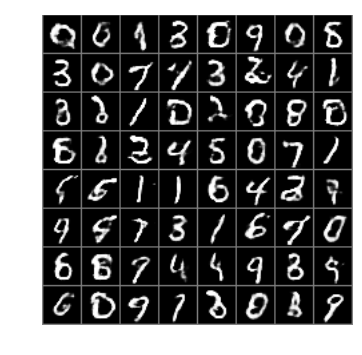

(7100, 0.69732606, 0.9889884)
not training discriminator


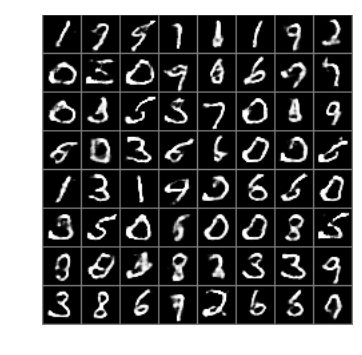

(7150, 0.67348635, 0.9975183)
not training discriminator


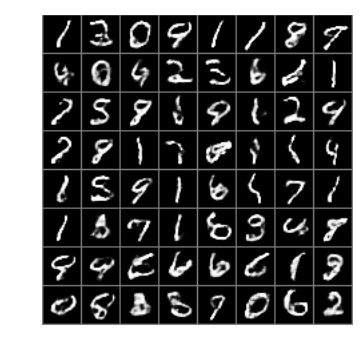

(7200, 0.74475706, 1.1488912)
not training discriminator


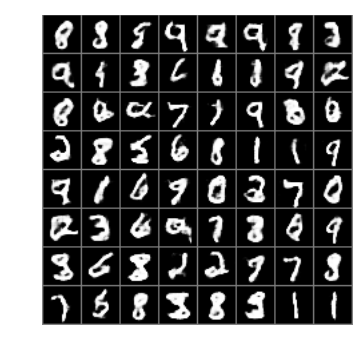

(7250, 0.71890503, 1.0860134)
not training discriminator


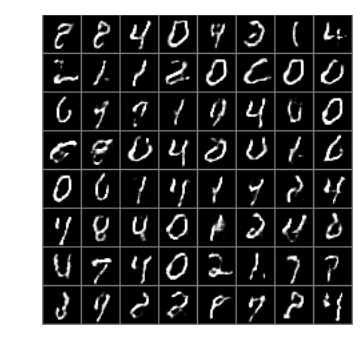

(7300, 0.62401098, 0.85012704)
not training discriminator


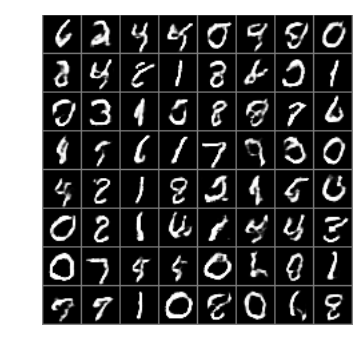

(7350, 0.75886458, 1.2629368)
not training discriminator


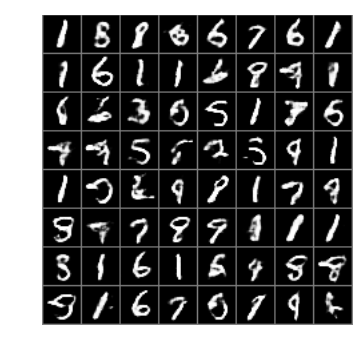

(7400, 0.66644078, 0.92223293)
not training discriminator


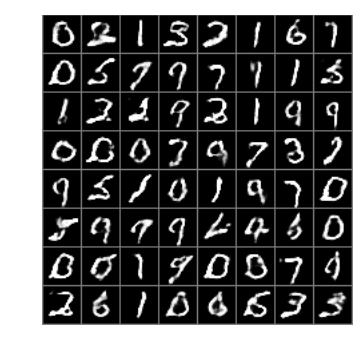

(7450, 0.64066029, 0.92863649)
not training discriminator


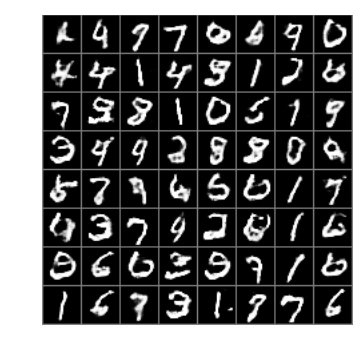

(7500, 0.69488585, 0.92805052)


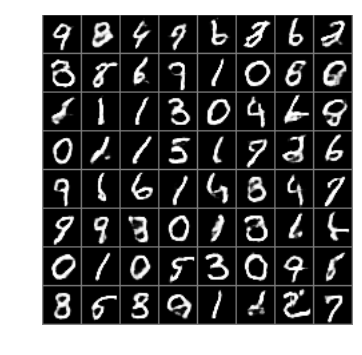

(7550, 0.66301835, 0.92130232)
not training discriminator


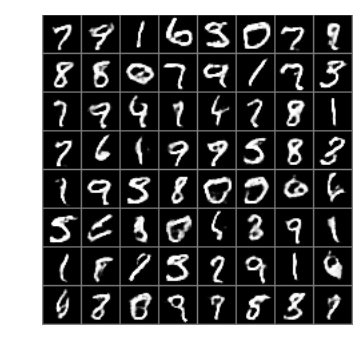

(7600, 0.6722005, 1.0117345)
not training discriminator


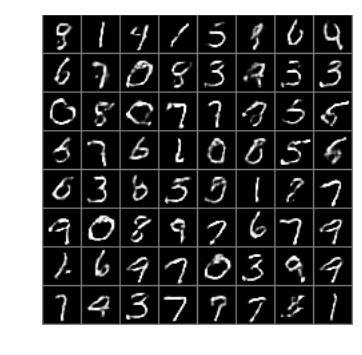

(7650, 0.70615447, 0.99682134)
not training discriminator


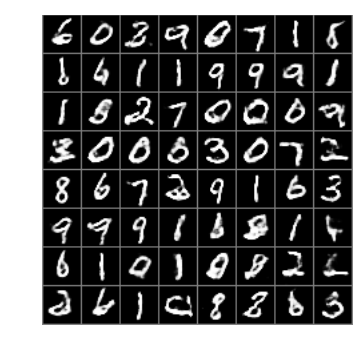

(7700, 0.7165702, 1.1061087)
not training discriminator


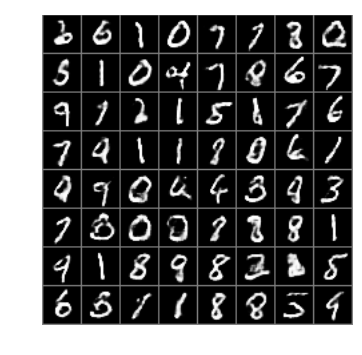

(7750, 0.67482078, 0.93703401)
not training discriminator


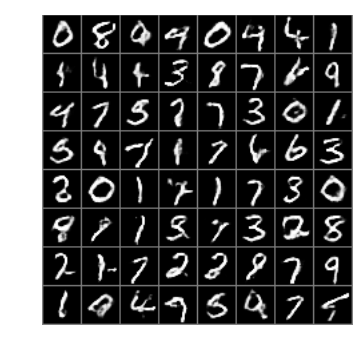

(7800, 0.67894685, 0.92899734)
not training discriminator


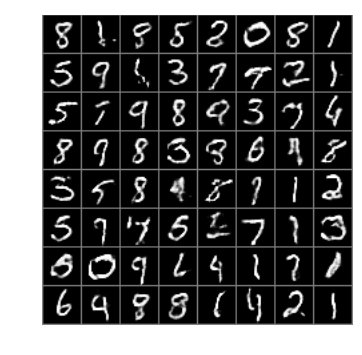

(7850, 0.64017522, 0.93719435)
not training discriminator


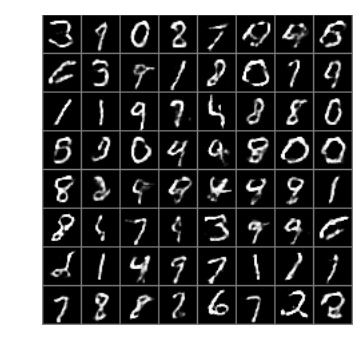

(7900, 0.64350045, 0.85611397)


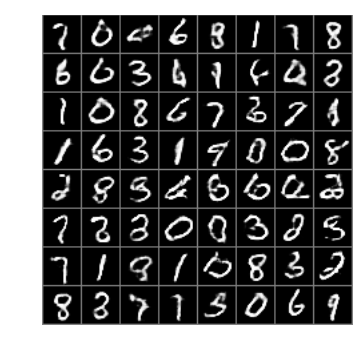

(7950, 0.64831096, 0.84685659)


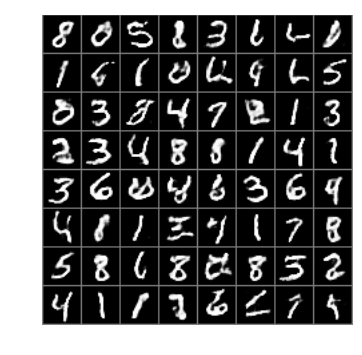

(8000, 0.68718523, 1.038722)
not training discriminator


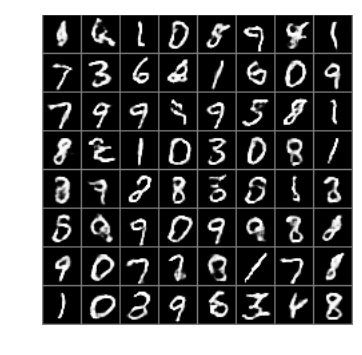

(8050, 0.6618638, 0.95762753)
not training discriminator


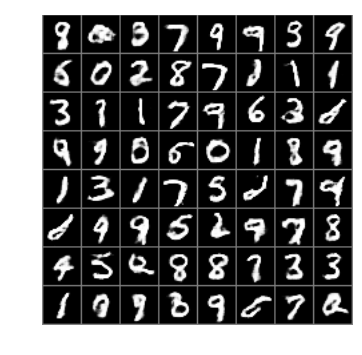

(8100, 0.62377429, 0.86778599)
not training discriminator


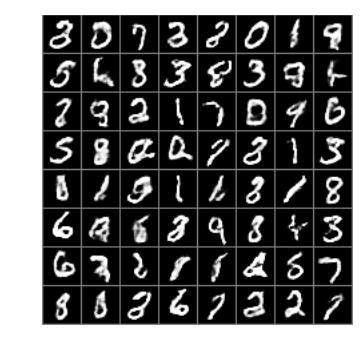

(8150, 0.65635008, 1.021593)
not training discriminator


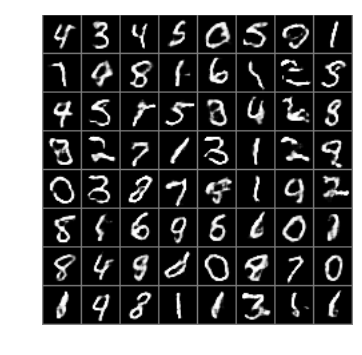

(8200, 0.69362593, 0.97348642)
not training discriminator


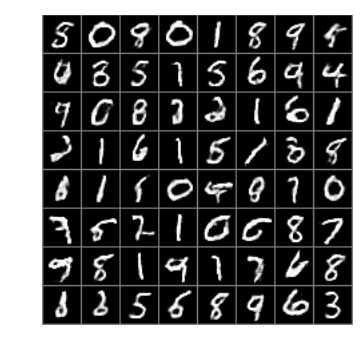

(8250, 0.69535863, 0.99234384)
not training discriminator


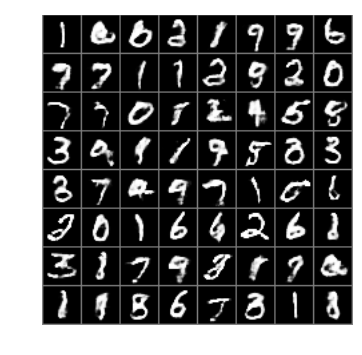

(8300, 0.66086102, 0.97798961)
not training discriminator


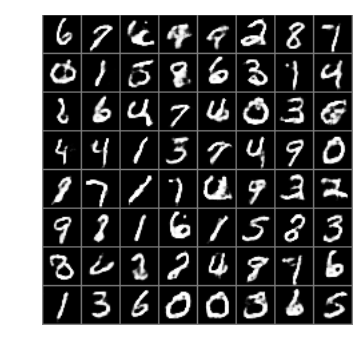

(8350, 0.69275856, 1.0171924)
not training discriminator


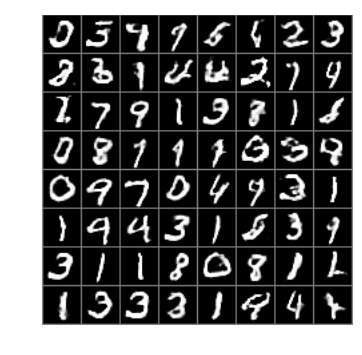

(8400, 0.70559537, 0.92937279)


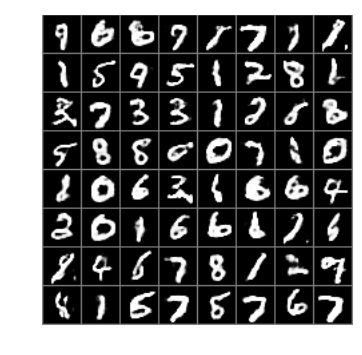

(8450, 0.67780942, 0.99704093)
not training discriminator


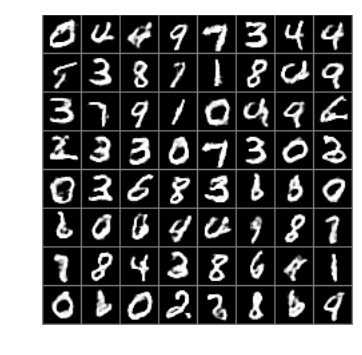

(8500, 0.66268247, 0.9382925)
not training discriminator


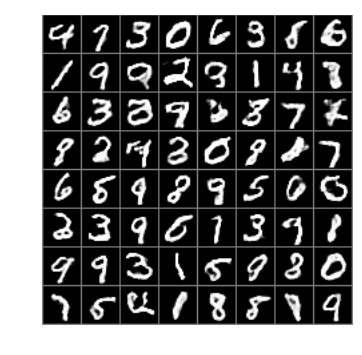

(8550, 0.67287827, 0.92090589)
not training discriminator


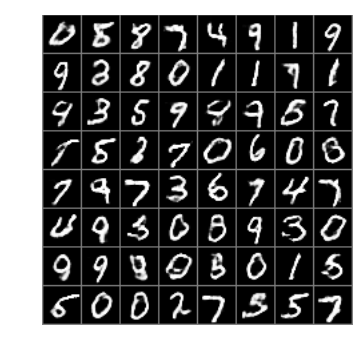

(8600, 0.66020286, 0.85269558)


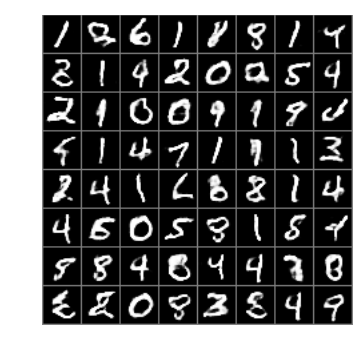

(8650, 0.62885094, 0.95805097)
not training discriminator


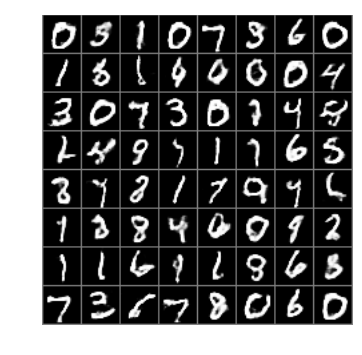

(8700, 0.68159521, 0.96507269)
not training discriminator


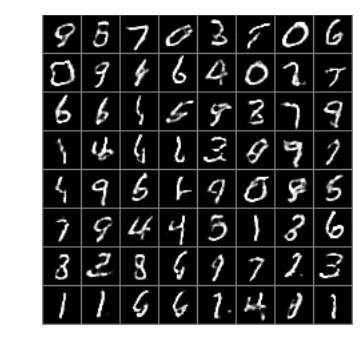

(8750, 0.62636507, 0.90936768)
not training discriminator


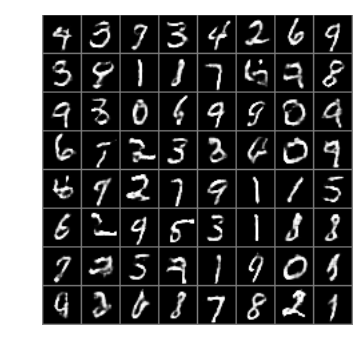

(8800, 0.66888928, 0.91620934)
not training discriminator


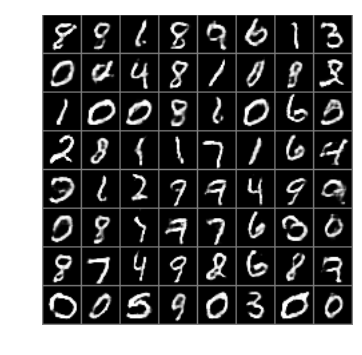

(8850, 0.70450658, 1.0725396)
not training discriminator


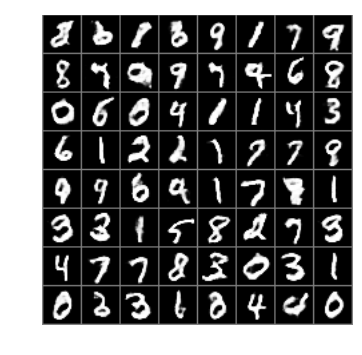

(8900, 0.65313935, 0.87557077)


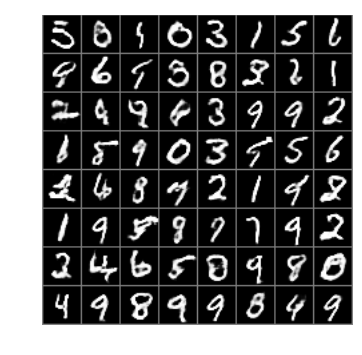

(8950, 0.6641627, 0.57188869)


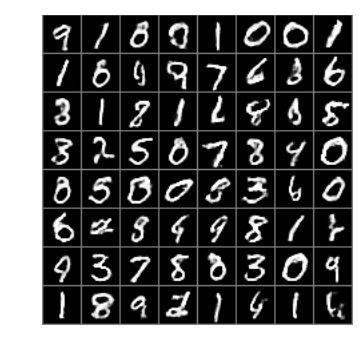

(9000, 0.65686506, 0.93752271)
not training discriminator


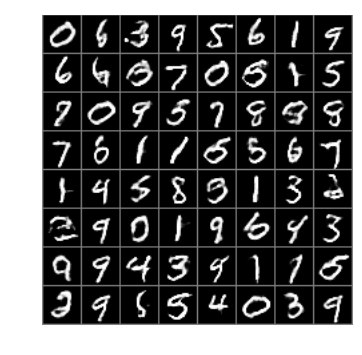

(9050, 0.69942033, 0.99991369)
not training discriminator


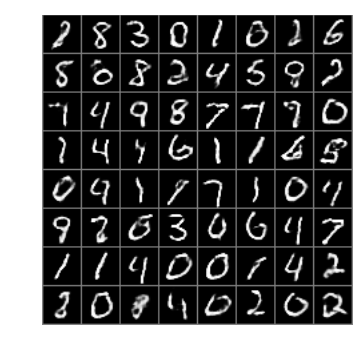

(9100, 0.59858, 0.75492734)


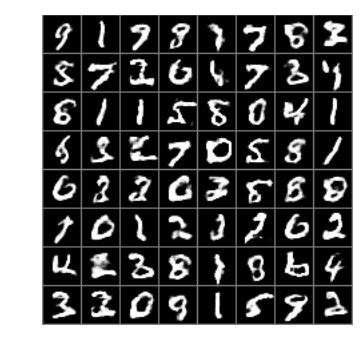

(9150, 0.65960401, 0.96078551)
not training discriminator


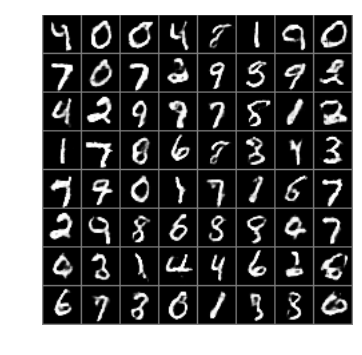

(9200, 0.66947275, 0.93388271)
not training discriminator


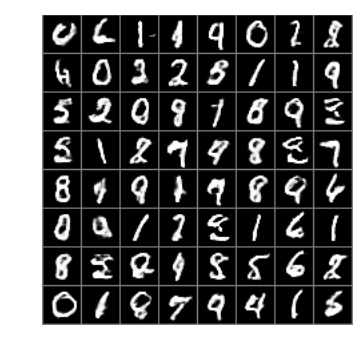

(9250, 0.69792724, 1.021122)
not training discriminator


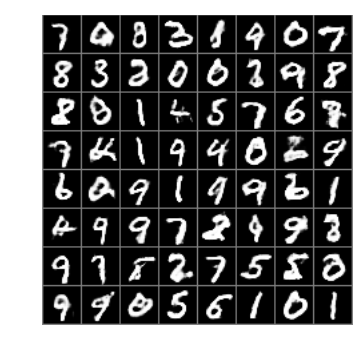

(9300, 0.65400255, 0.93058348)
not training discriminator


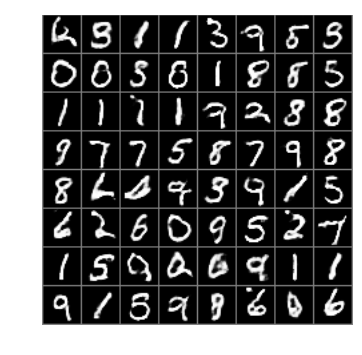

(9350, 0.65692019, 0.85109901)


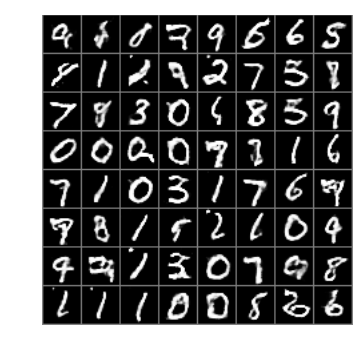

(9400, 0.66900009, 0.9811039)
not training discriminator


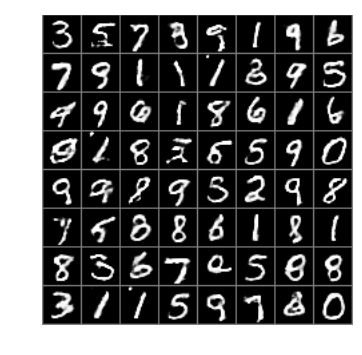

(9450, 0.67158544, 0.95705676)
not training discriminator


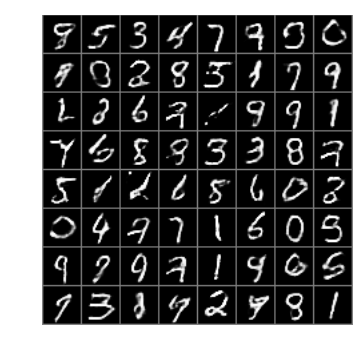

(9500, 0.68322015, 1.0124483)
not training discriminator


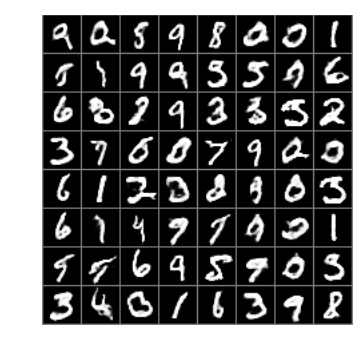

(9550, 0.64989895, 0.9736796)
not training discriminator


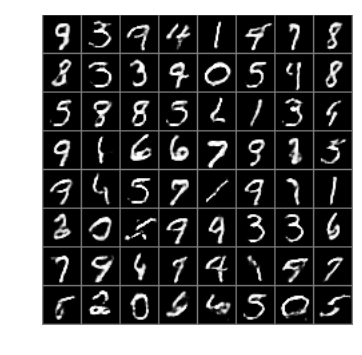

(9600, 0.68850976, 0.96051371)
not training discriminator


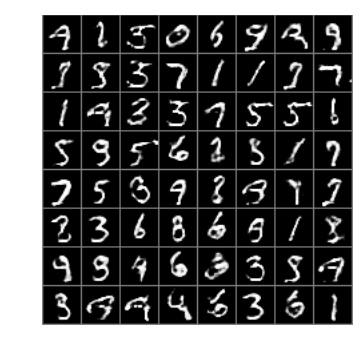

(9650, 0.62763917, 0.68839711)


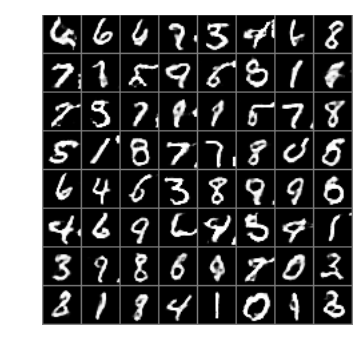

(9700, 0.66150975, 0.96924758)
not training discriminator


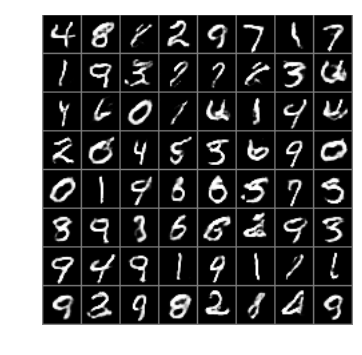

(9750, 0.64932418, 0.94265044)
not training discriminator


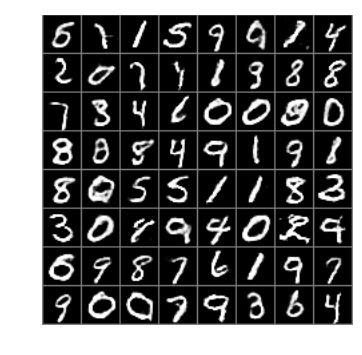

(9800, 0.67167234, 0.94693255)
not training discriminator


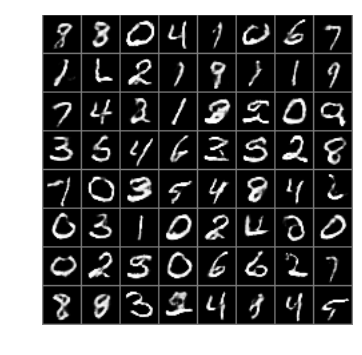

(9850, 0.68027681, 0.99262249)
not training discriminator


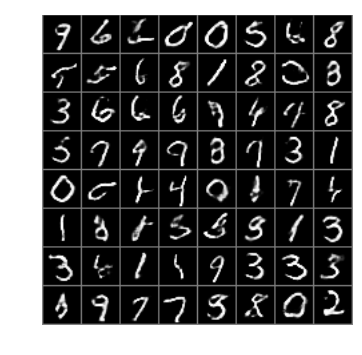

(9900, 0.67320144, 1.0090518)
not training discriminator


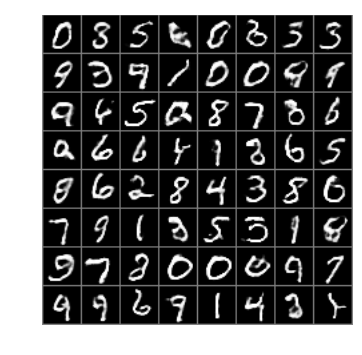

(9950, 0.66275418, 0.96980035)
not training discriminator


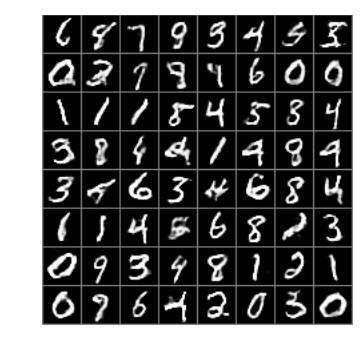

(10000, 0.70502567, 0.92293978)


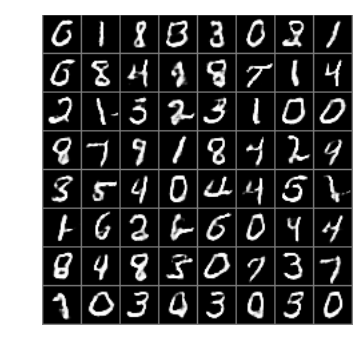

(10050, 0.69063812, 1.1001332)
not training discriminator


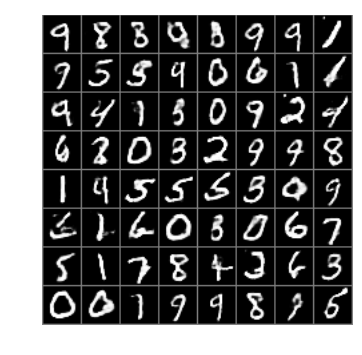

(10100, 0.67146444, 0.89431477)


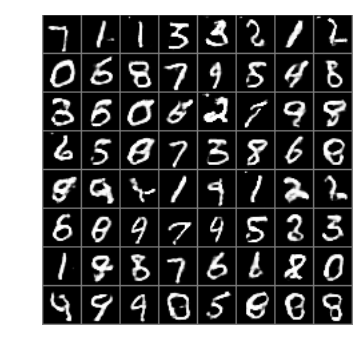

(10150, 0.73121393, 1.2237296)
not training discriminator


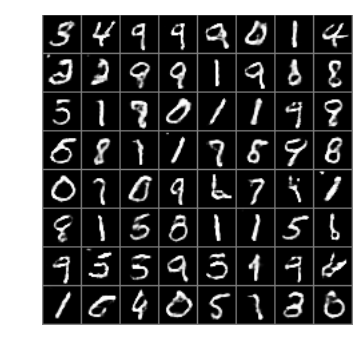

(10200, 0.61540145, 0.80598861)


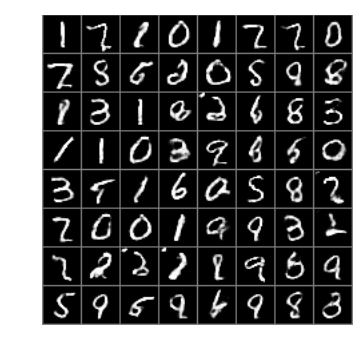

(10250, 0.79536355, 1.0748857)
not training discriminator


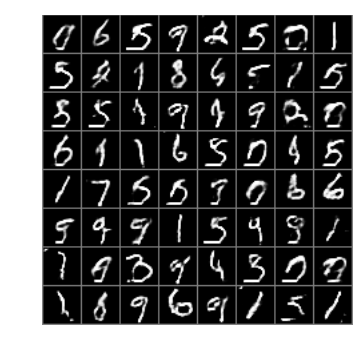

(10300, 0.66863364, 0.97627282)
not training discriminator


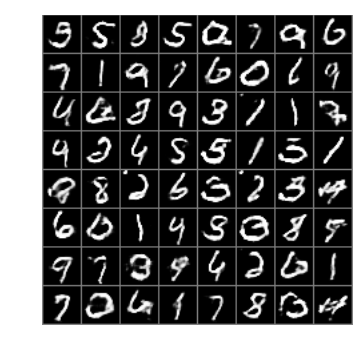

(10350, 0.73964727, 1.1152079)
not training discriminator


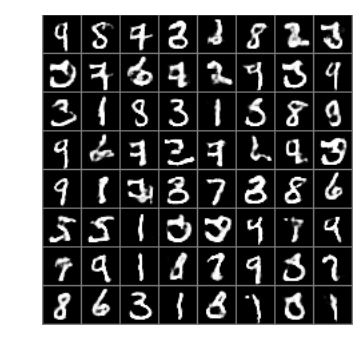

(10400, 0.64483857, 0.90524453)
not training discriminator


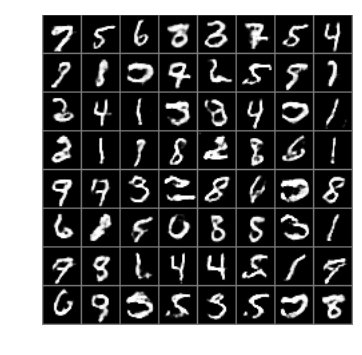

(10450, 0.68721163, 1.0012124)
not training discriminator


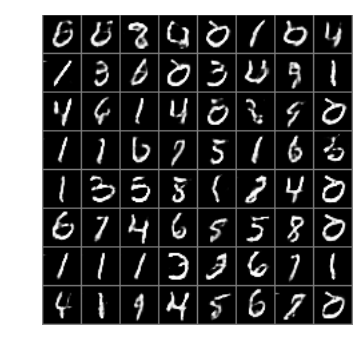

(10500, 0.69544876, 1.0109866)
not training discriminator


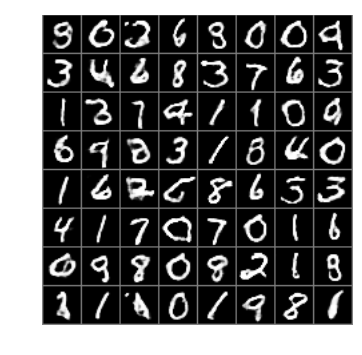

(10550, 0.67785001, 0.91133738)


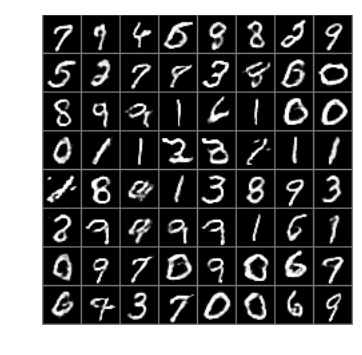

(10600, 0.68818456, 0.94735855)
not training discriminator


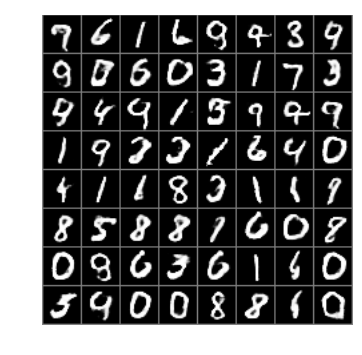

(10650, 0.64981055, 1.0583972)
not training discriminator


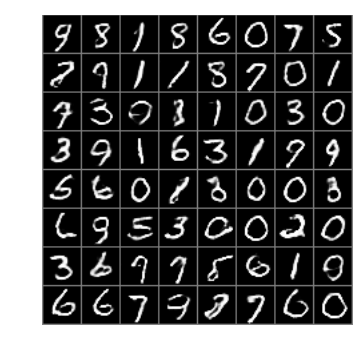

(10700, 0.64074767, 1.0930934)
not training discriminator


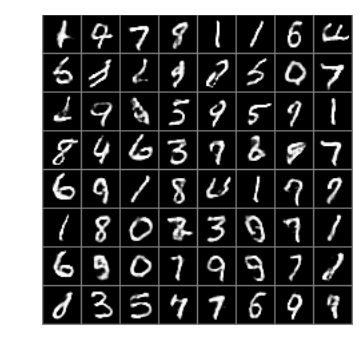

(10750, 0.6819073, 1.0177674)
not training discriminator


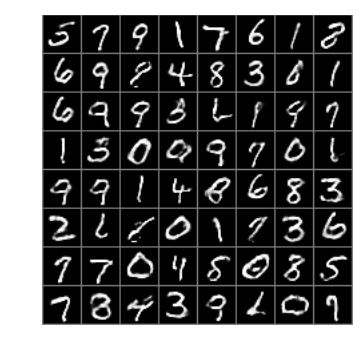

(10800, 0.60655081, 0.954669)
not training discriminator


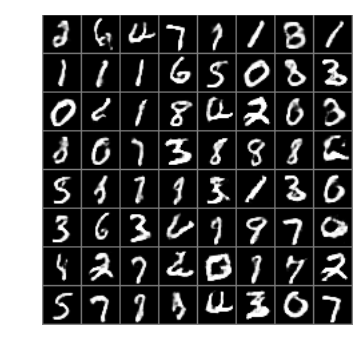

(10850, 0.68786299, 0.92215109)


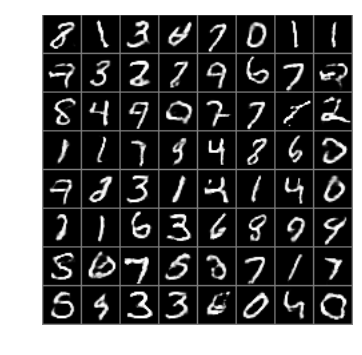

(10900, 0.68850332, 1.080485)
not training discriminator


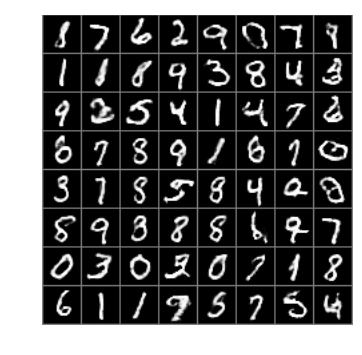

(10950, 0.63116372, 0.77639925)


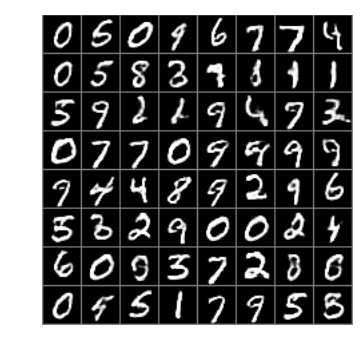

(11000, 0.68418264, 0.94056821)
not training discriminator


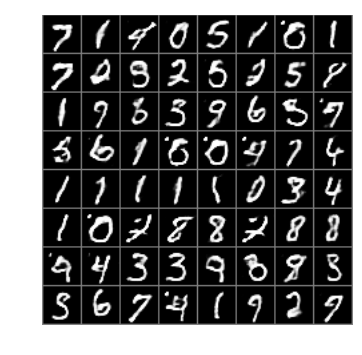

(11050, 0.71276462, 1.0240252)
not training discriminator


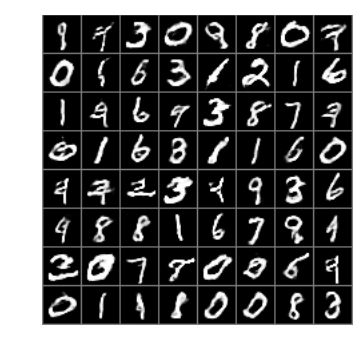

(11100, 0.70163667, 0.94231188)


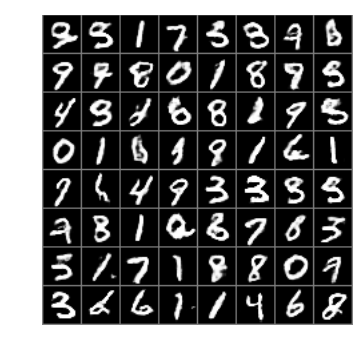

(11150, 0.66236889, 0.96981436)
not training discriminator


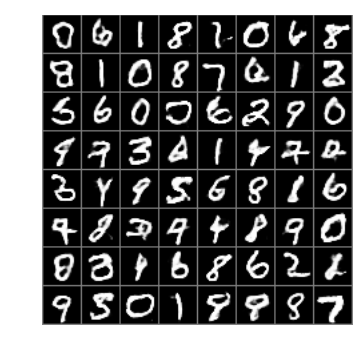

(11200, 0.67446411, 0.59658587)


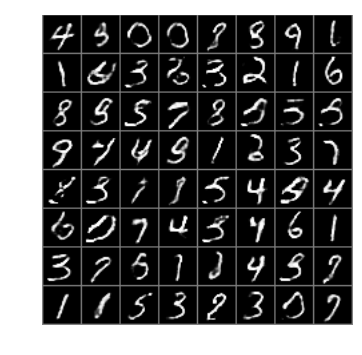

(11250, 0.67778778, 1.0533397)
not training discriminator


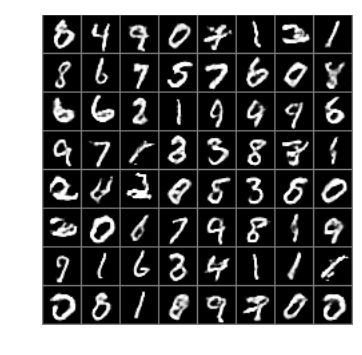

(11300, 0.71401954, 0.94750667)


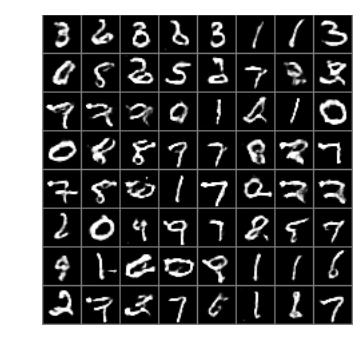

(11350, 0.68136787, 1.1631298)
not training discriminator


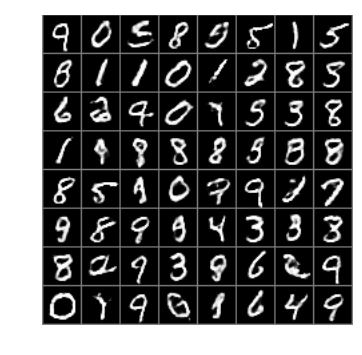

(11400, 0.78637493, 1.0853243)
not training discriminator


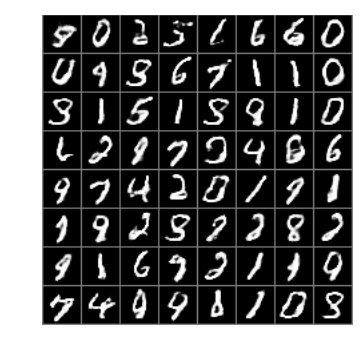

(11450, 0.8320089, 1.2360957)
not training discriminator


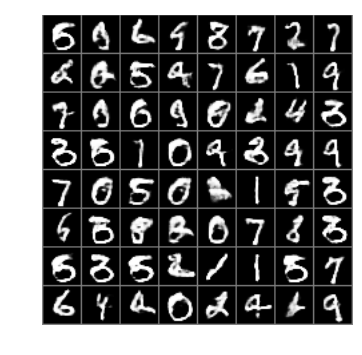

(11500, 0.71904838, 1.1250317)
not training discriminator


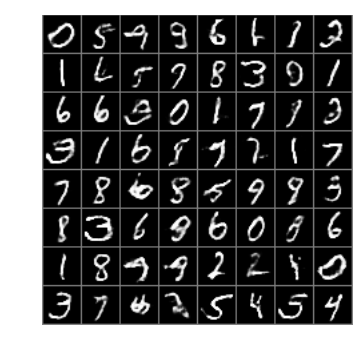

(11550, 0.66196507, 1.0305768)
not training discriminator


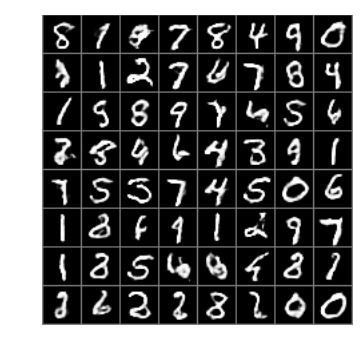

(11600, 0.8002128, 1.1910104)
not training discriminator


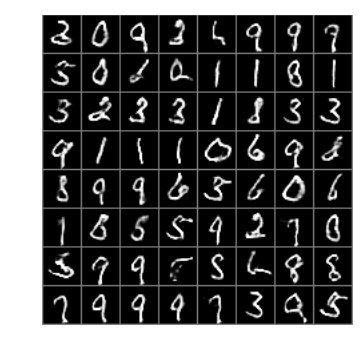

(11650, 0.61953342, 0.97943759)
not training discriminator


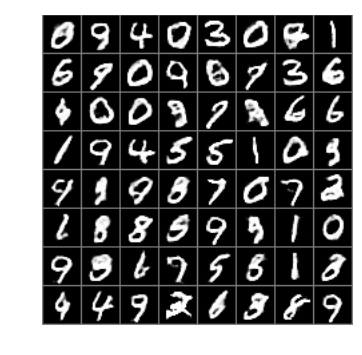

(11700, 0.63322586, 0.89957786)
not training discriminator


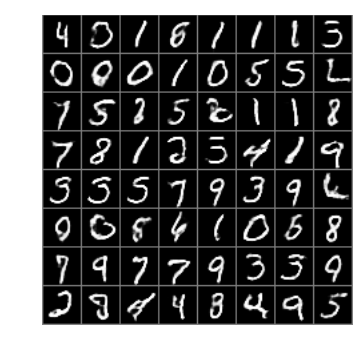

(11750, 0.66421944, 0.94952464)
not training discriminator


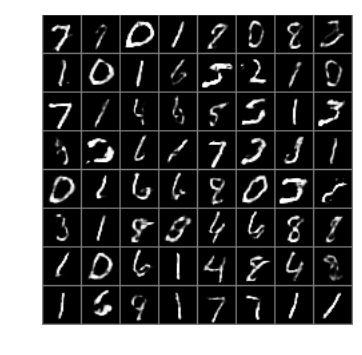

(11800, 0.5985052, 0.83518803)
not training discriminator


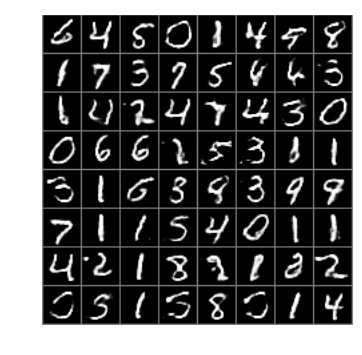

(11850, 0.65410912, 0.92371303)
not training discriminator


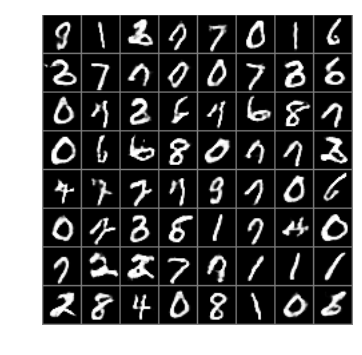

(11900, 0.65508056, 0.94230604)
not training discriminator


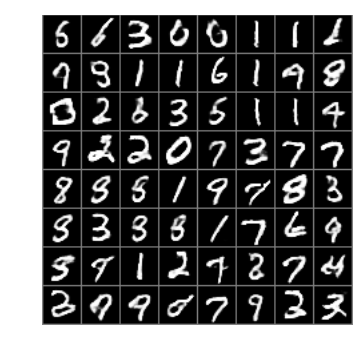

(11950, 0.63609421, 0.96967626)
not training discriminator


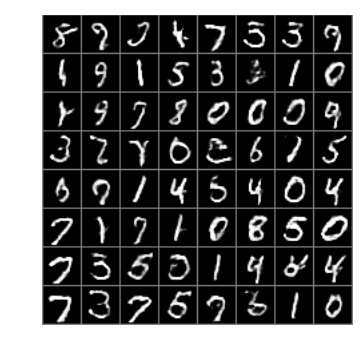

(12000, 0.71473002, 1.1577886)
not training discriminator


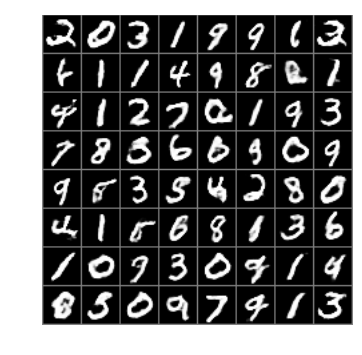

(12050, 0.67119443, 1.004936)
not training discriminator


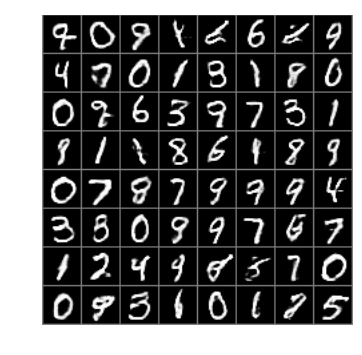

(12100, 0.7016418, 0.9194479)


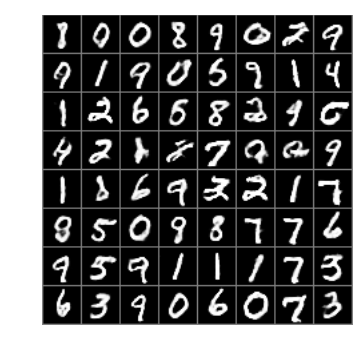

(12150, 0.67844141, 0.96965241)
not training discriminator


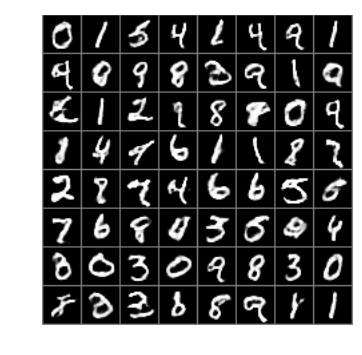

(12200, 0.62801385, 0.92187595)
not training discriminator


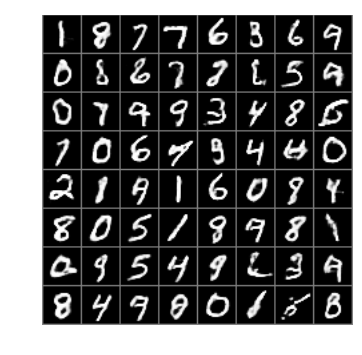

(12250, 0.68292457, 0.59508973)


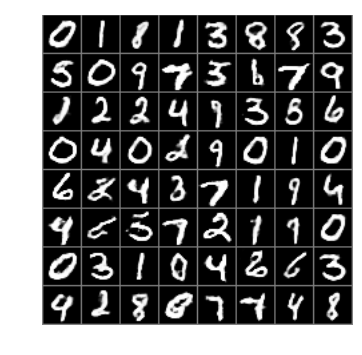

(12300, 0.70386648, 0.95125103)
not training discriminator


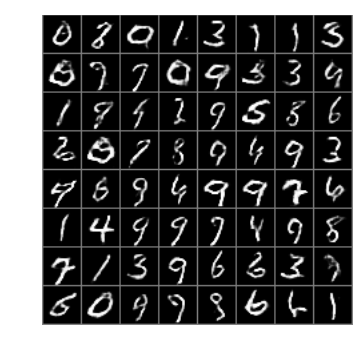

(12350, 0.73504442, 1.1293175)
not training discriminator


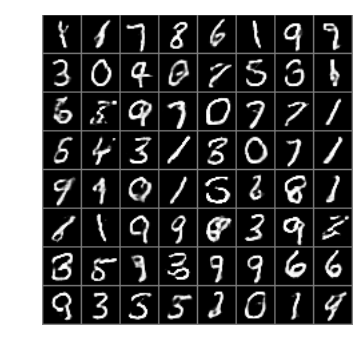

(12400, 0.7198258, 1.0994701)
not training discriminator


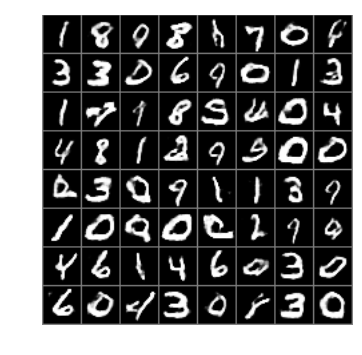

(12450, 0.60928327, 0.88521397)
not training discriminator


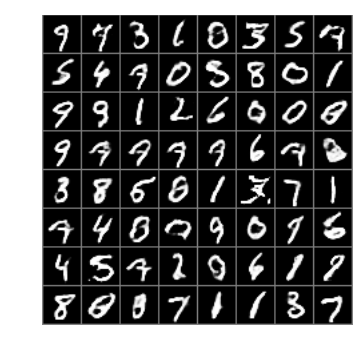

(12500, 0.60225475, 0.88818538)
not training discriminator


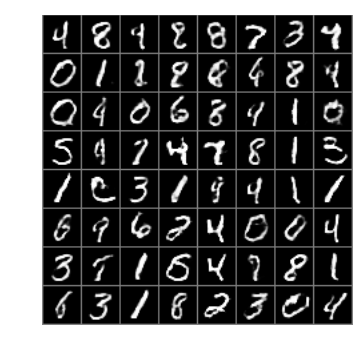

(12550, 0.68782377, 0.9436897)
not training discriminator


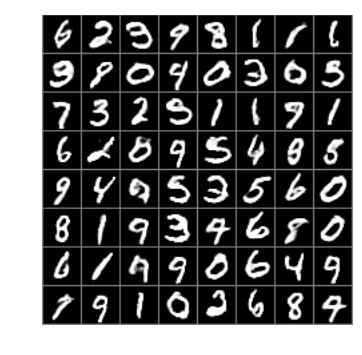

(12600, 0.67198384, 0.92408192)
not training discriminator


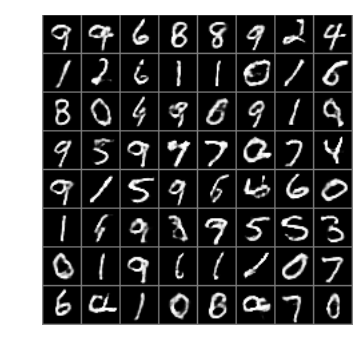

(12650, 0.71351111, 1.0587076)
not training discriminator


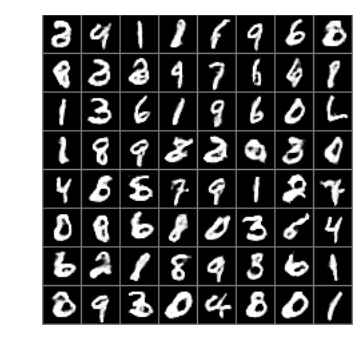

(12700, 0.7319445, 1.2307717)
not training discriminator


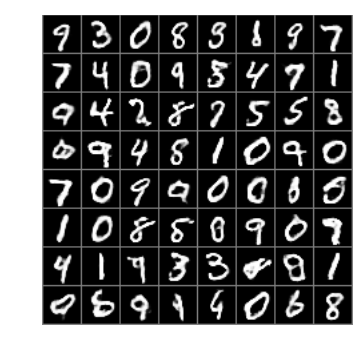

(12750, 0.70749056, 0.89285564)


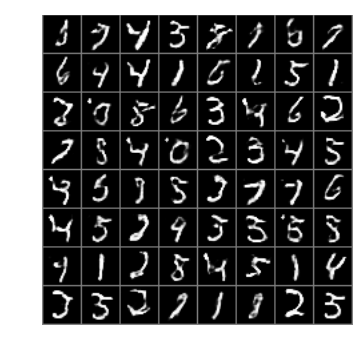

(12800, 0.64123392, 0.83957946)


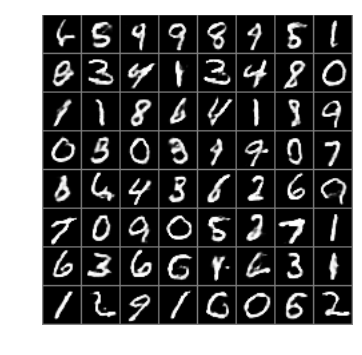

(12850, 0.65394342, 0.67265928)


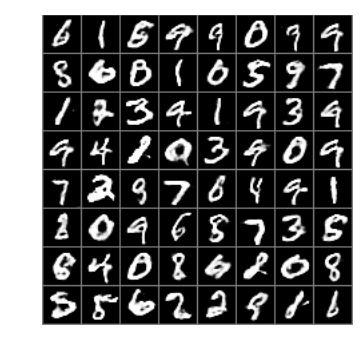

(12900, 0.64432144, 0.91650319)
not training discriminator


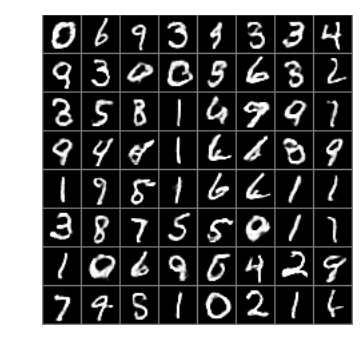

(12950, 0.64364815, 0.87466329)
not training discriminator


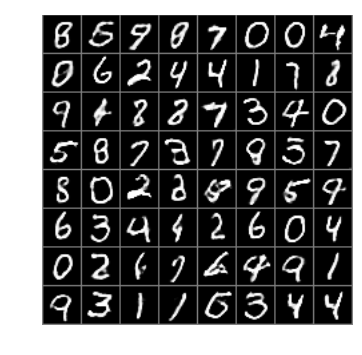

(13000, 0.7206986, 1.1084982)
not training discriminator


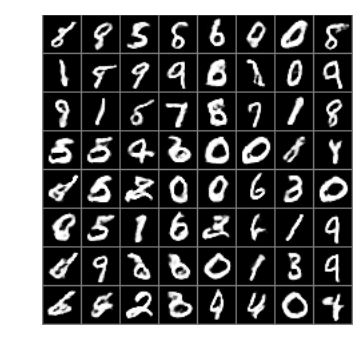

(13050, 0.68502361, 1.0495868)
not training discriminator


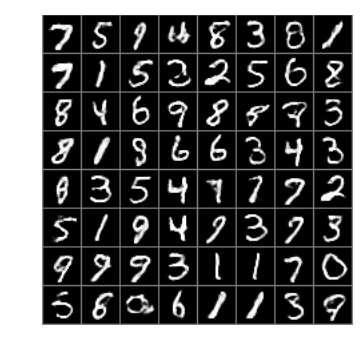

(13100, 0.65945011, 0.77884281)


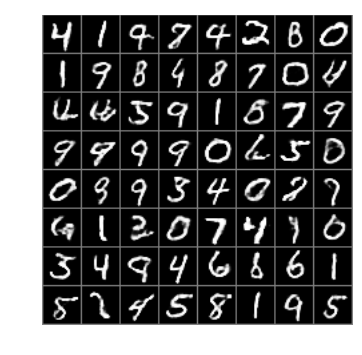

(13150, 0.58565593, 0.97663033)
not training discriminator


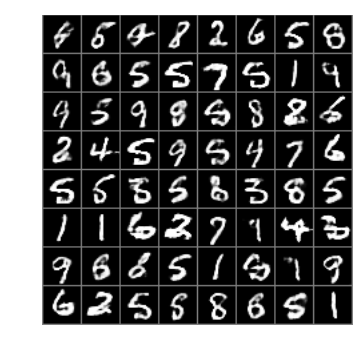

(13200, 0.6367712, 1.0744448)
not training discriminator


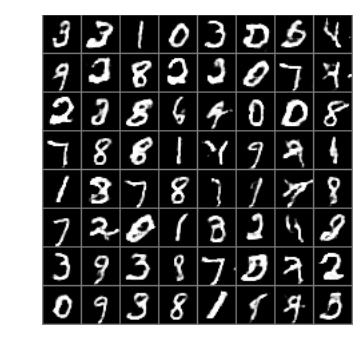

(13250, 0.70664716, 1.0474255)
not training discriminator


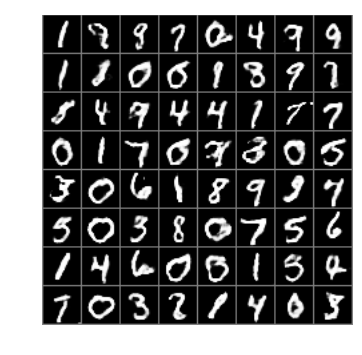

(13300, 0.69113719, 0.86575711)


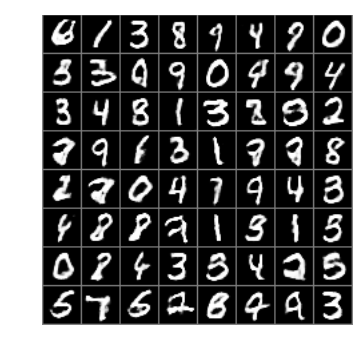

(13350, 0.69635433, 0.96394515)
not training discriminator


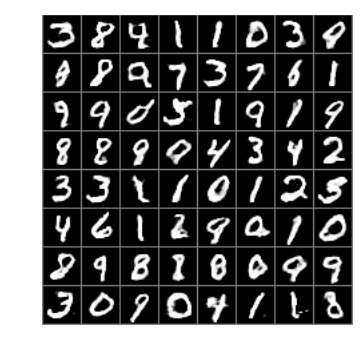

(13400, 0.68294847, 0.94172716)
not training discriminator


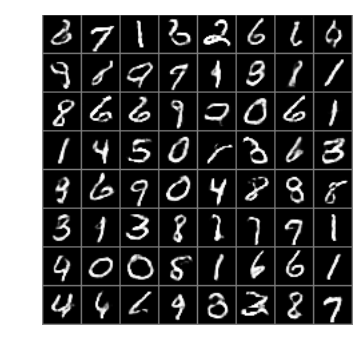

(13450, 0.64964485, 1.0309274)
not training discriminator


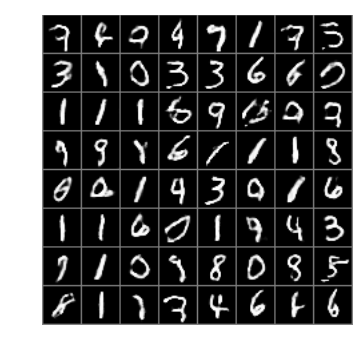

(13500, 0.68094015, 0.95367563)
not training discriminator


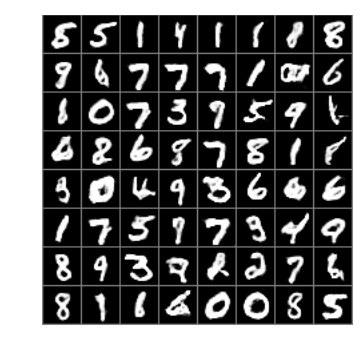

(13550, 0.62790203, 0.89260709)
not training discriminator


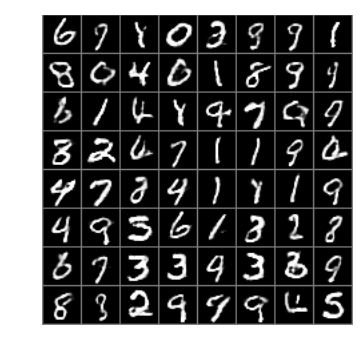

(13600, 0.66619074, 1.0253901)
not training discriminator


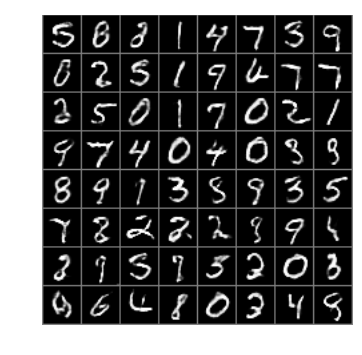

(13650, 0.63567233, 0.89384466)
not training discriminator


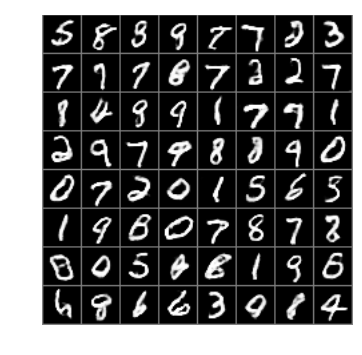

(13700, 0.73487377, 1.0789915)
not training discriminator


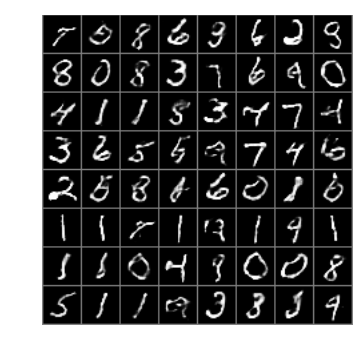

(13750, 0.64985979, 0.61753619)


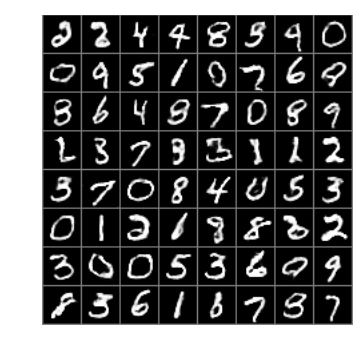

(13800, 0.6679973, 0.93441981)
not training discriminator


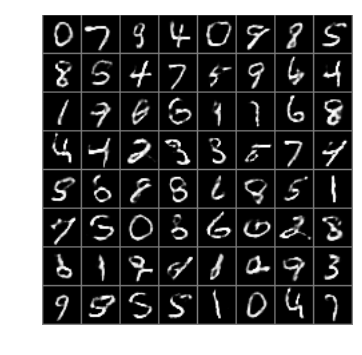

(13850, 0.6623705, 0.8898809)


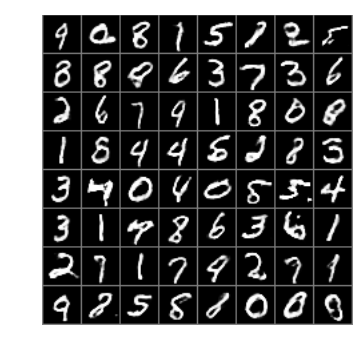

(13900, 0.66749859, 0.54177272)


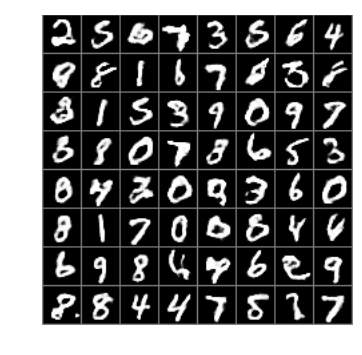

(13950, 0.6094752, 0.67514372)


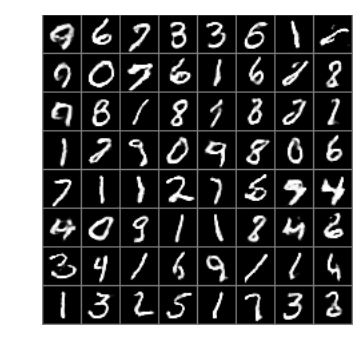

(14000, 0.64925641, 0.88292456)
not training discriminator


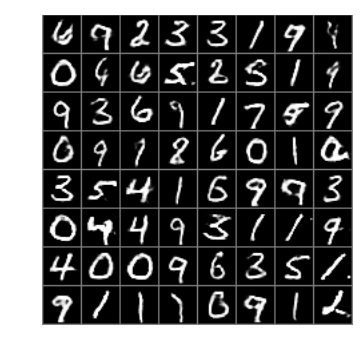

(14050, 0.69562471, 0.9201473)


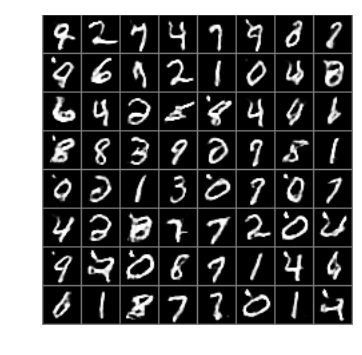

(14100, 0.69419545, 1.0041089)
not training discriminator


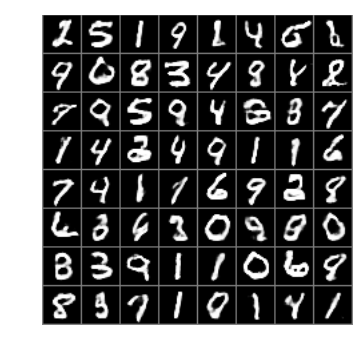

(14150, 0.64823306, 0.98755968)
not training discriminator


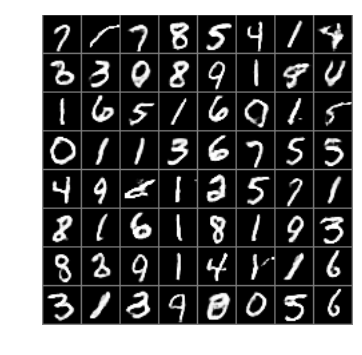

(14200, 0.63668841, 0.94536722)
not training discriminator


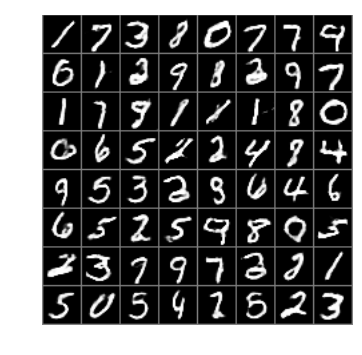

(14250, 0.68989491, 1.1140252)
not training discriminator


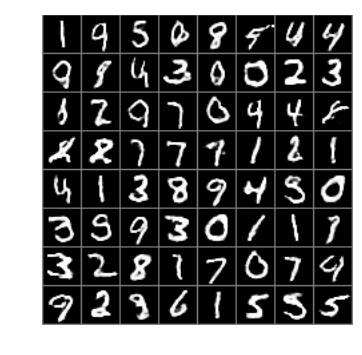

(14300, 0.7147361, 1.0120268)
not training discriminator


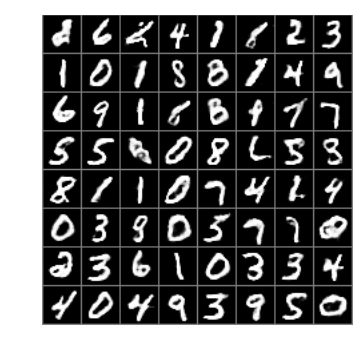

(14350, 0.63640964, 0.81268752)


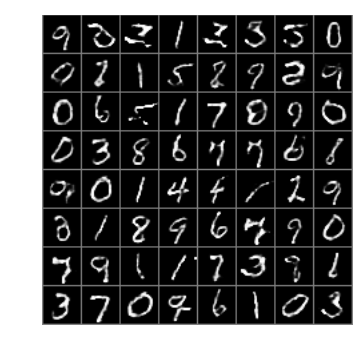

(14400, 0.74165106, 1.1363317)
not training discriminator


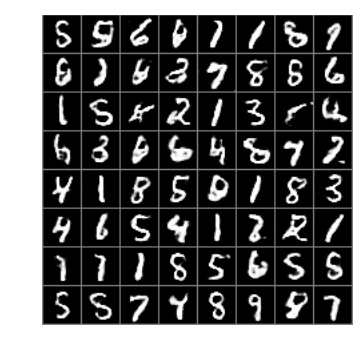

(14450, 0.63619244, 1.0033937)
not training discriminator


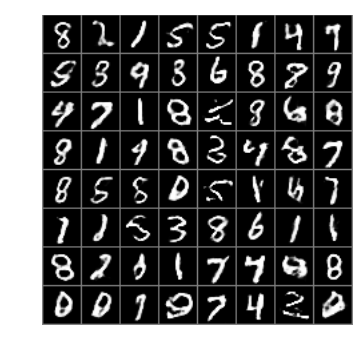

(14500, 0.68319345, 1.0059525)
not training discriminator


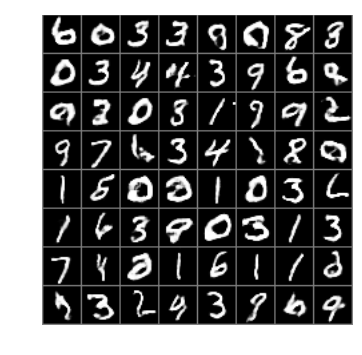

(14550, 0.66273999, 0.95221817)
not training discriminator


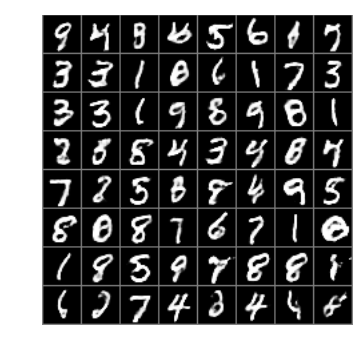

(14600, 0.65717781, 0.9331255)
not training discriminator


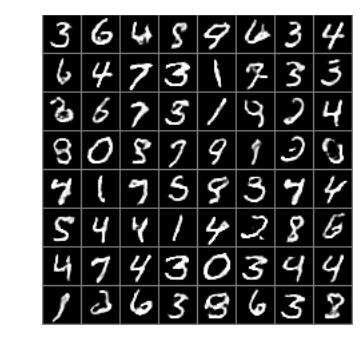

(14650, 0.64306825, 0.65298557)


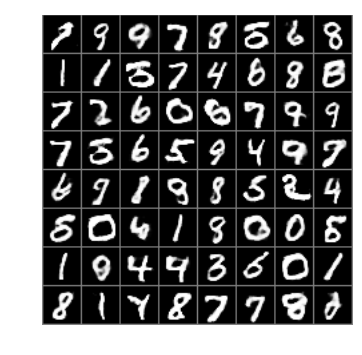

(14700, 0.72888935, 1.0551935)
not training discriminator


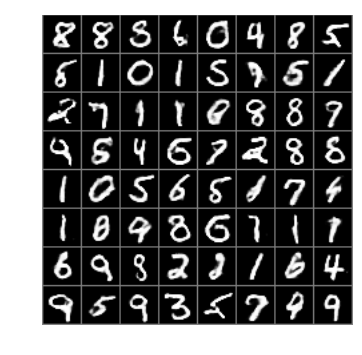

(14750, 0.6248138, 1.0095052)
not training discriminator


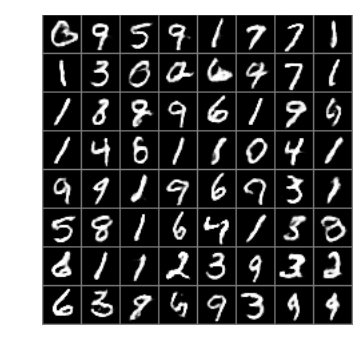

(14800, 0.63696647, 0.84163326)


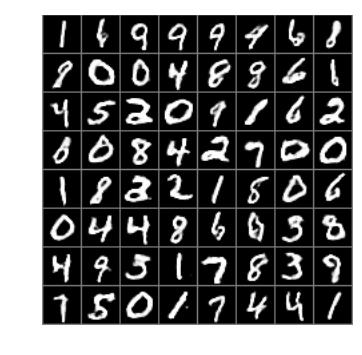

(14850, 0.71008396, 1.0080919)
not training discriminator


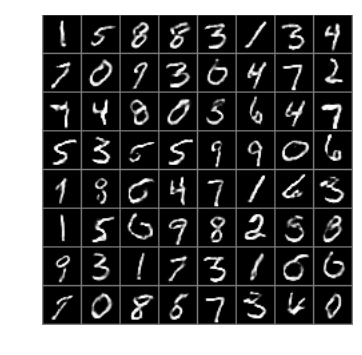

(14900, 0.7092014, 0.91371977)


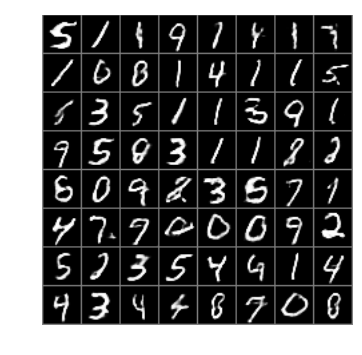

(14950, 0.65461063, 0.89455795)
not training discriminator


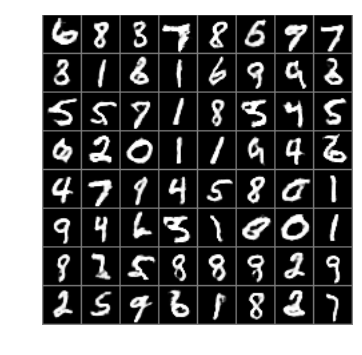

(15000, 0.70751894, 1.0523241)
not training discriminator


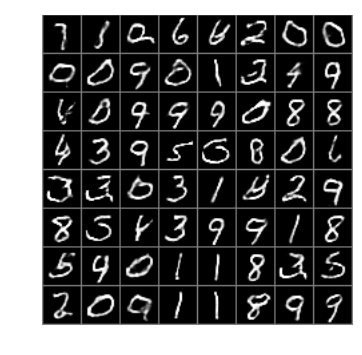

(15050, 0.69497776, 1.0164169)
not training discriminator


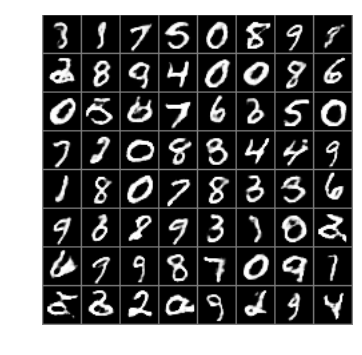

(15100, 0.71971679, 0.99377012)
not training discriminator


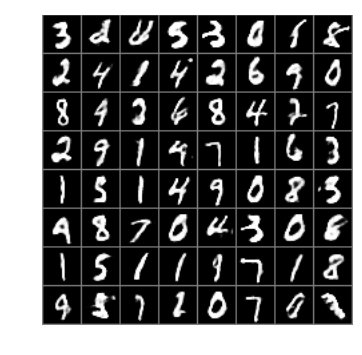

(15150, 0.65828216, 1.0295656)
not training discriminator


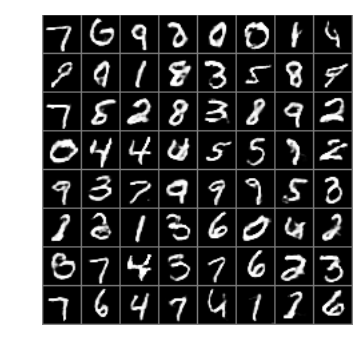

(15200, 0.59915727, 0.93794554)
not training discriminator


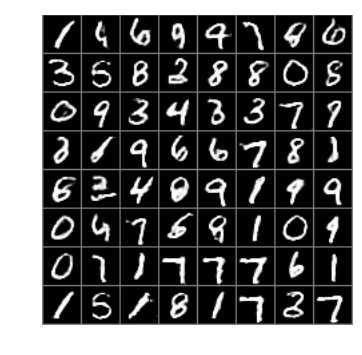

(15250, 0.65108347, 0.67609513)


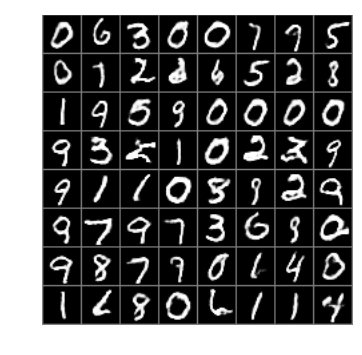

(15300, 0.78336656, 1.2728207)
not training discriminator


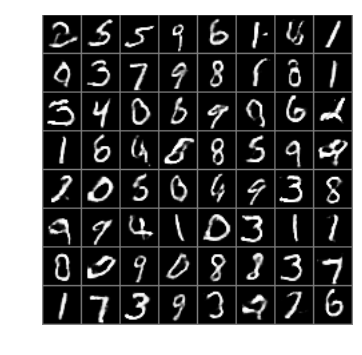

(15350, 0.77167141, 1.1175126)
not training discriminator


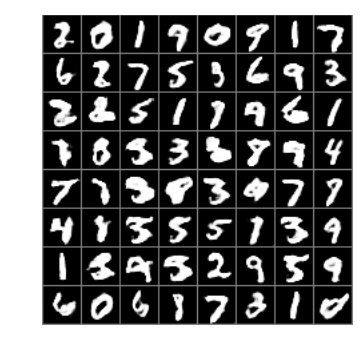

(15400, 0.67253768, 1.1031188)
not training discriminator


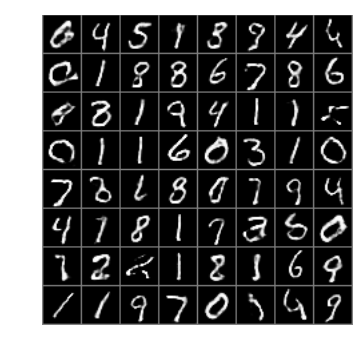

(15450, 0.65821332, 0.97973728)
not training discriminator


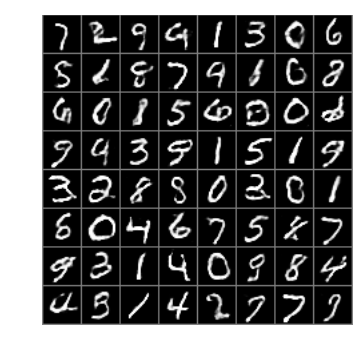

(15500, 0.73176408, 1.1419241)
not training discriminator


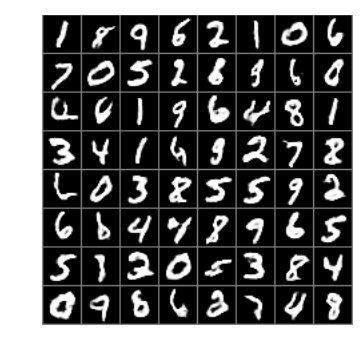

(15550, 0.64799821, 0.88773197)
not training discriminator


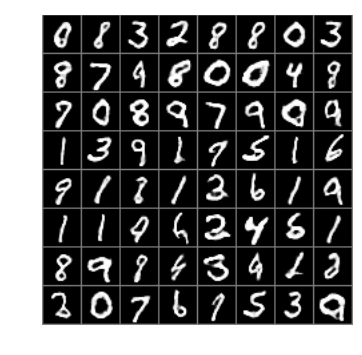

(15600, 0.63129598, 0.9590987)
not training discriminator


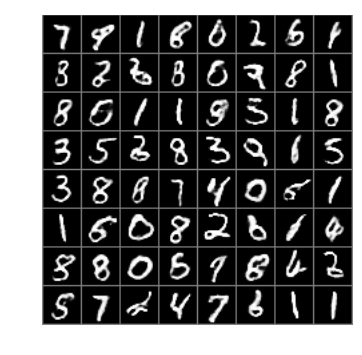

(15650, 0.65912724, 0.81228131)


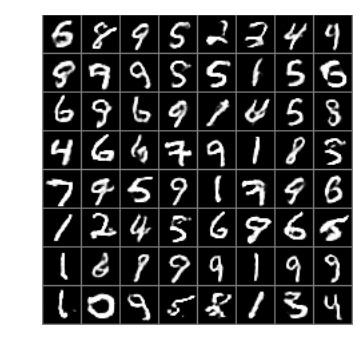

(15700, 0.63602662, 0.93275476)
not training discriminator


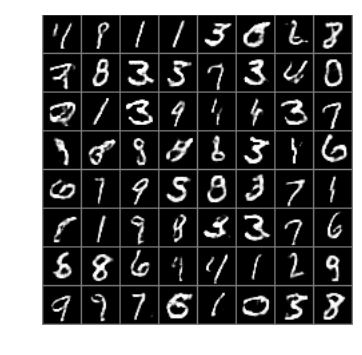

(15750, 0.71395212, 0.90513313)


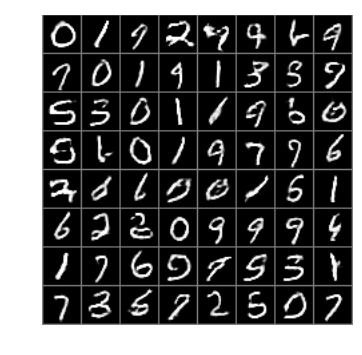

(15800, 0.73367667, 1.0630307)
not training discriminator


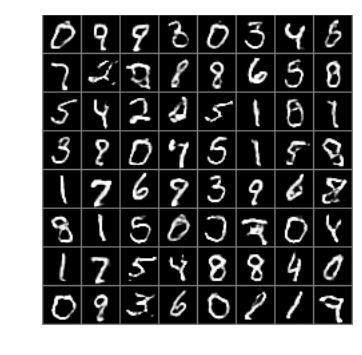

(15850, 0.65345156, 0.97341788)
not training discriminator


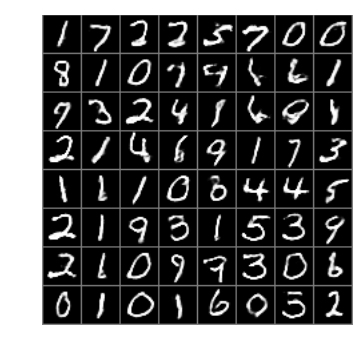

(15900, 0.72291917, 1.0731277)
not training discriminator


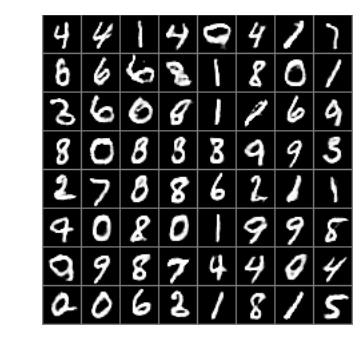

(15950, 0.6606847, 0.9030447)
not training discriminator


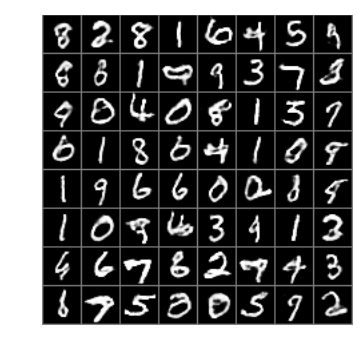

(16000, 0.68079126, 0.62471414)


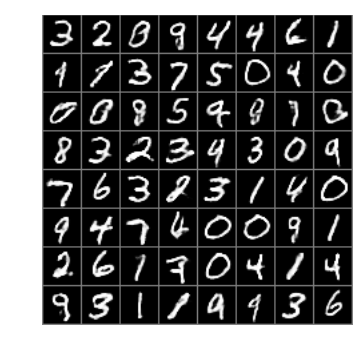

In [ ]:
for i in range(60000):
    train_d = True
    train_g = True
    keep_prob_train = 0.6 # 0.5
    
    
    n = np.random.uniform(0.0, 1.0, [batch_size, n_noise]).astype(np.float32)   
    batch = [np.reshape(b, [28, 28]) for b in mnist.train.next_batch(batch_size=batch_size)[0]]  
    
    d_real_ls, d_fake_ls, g_ls, d_ls = sess.run([loss_d_real, loss_d_fake, loss_g, loss_d], feed_dict={X_in: batch, noise: n, keep_prob: keep_prob_train, is_training:True})
    
    d_fake_ls_init = d_fake_ls
    
    d_real_ls = np.mean(d_real_ls)
    d_fake_ls = np.mean(d_fake_ls)
    g_ls = g_ls
    d_ls = d_ls
    
    
    
    
    if g_ls * 1.35 < d_ls:
        train_g = False
        pass
    if d_ls * 1.35 < g_ls:
        train_d = False
        pass
    
    
   
    
    if train_d:
        sess.run(optimizer_d, feed_dict={noise: n, X_in: batch, keep_prob: keep_prob_train, is_training:True})
        
        
    if train_g:
        sess.run(optimizer_g, feed_dict={noise: n, keep_prob: keep_prob_train, is_training:True})
        
        
    if not i % 50:
        print (i, d_ls, g_ls)
        if not train_g:
            print("not training generator")
        if not train_d:
            print("not training discriminator")
        gen_img = sess.run(g, feed_dict = {noise: n, keep_prob: 1.0, is_training:False})
        imgs = [img[:,:,0] for img in gen_img]
        m = montage(imgs)
        gen_img = m
        plt.axis('off')
        plt.imshow(gen_img, cmap='gray')
        plt.show()